# Chapter 2. 다양한 패턴의 2차원 상의 점을 구분해 내는 방법

## Step 0. 데이터 소개 및 학습목표

**데이터는 아래와 같은 생성 데이터를 기반으로 합니다.**



- 선형 관계를 가진 클러스터

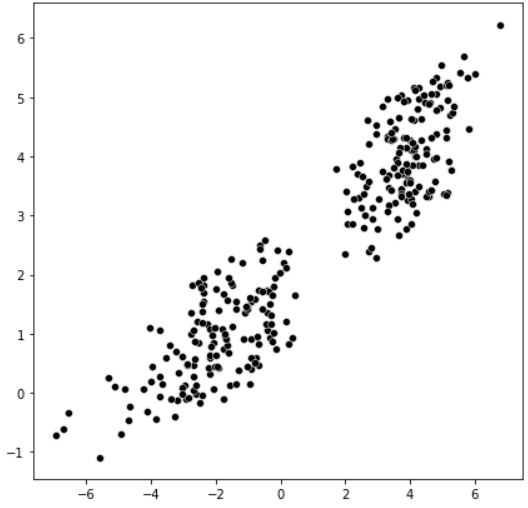

- 비선형 관계를 가진 클러스터
 - Concentric circles
 - Interleaving half circles
 - Spiral


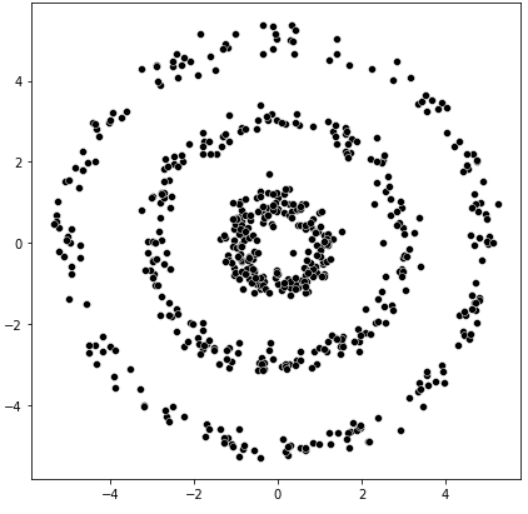

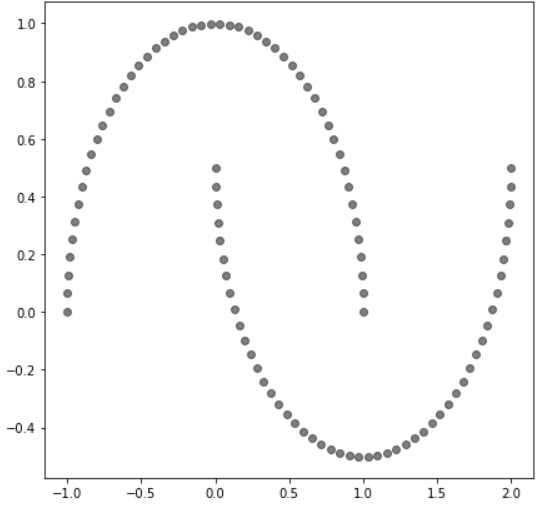

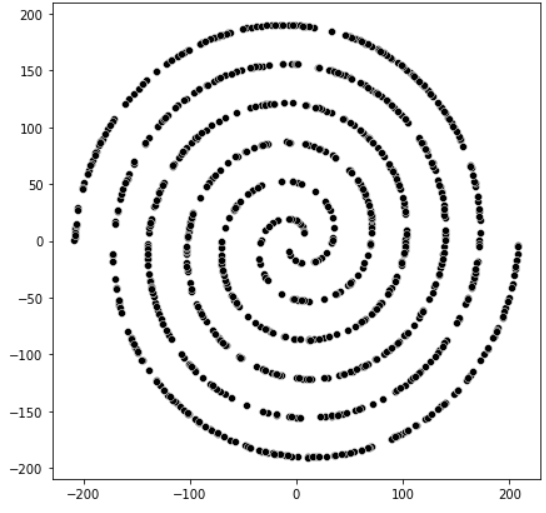

\- 아래는 데이터를 생성할 때 가정된 클러스터 정보입니다 (아래는 순서대로 X1, X2, X3, X4 입니다.)


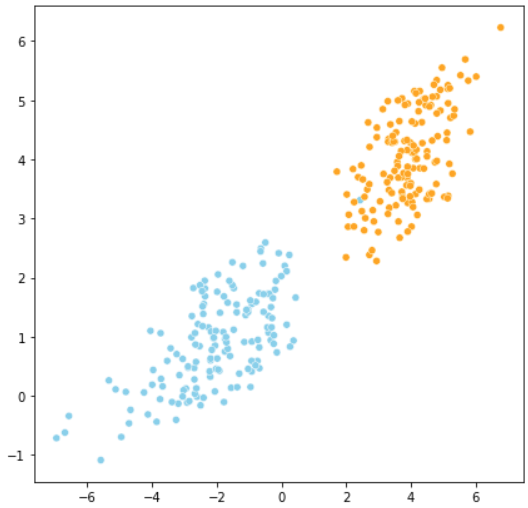

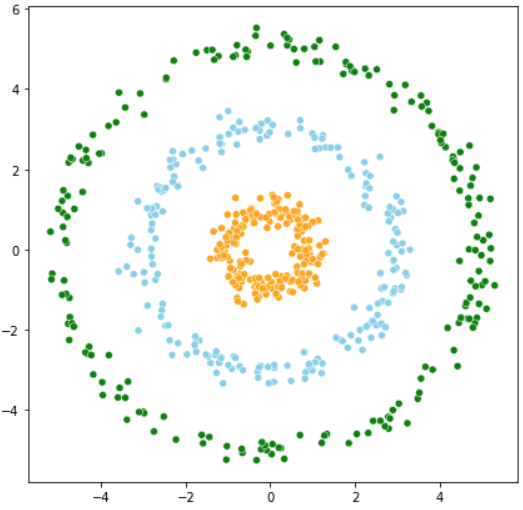

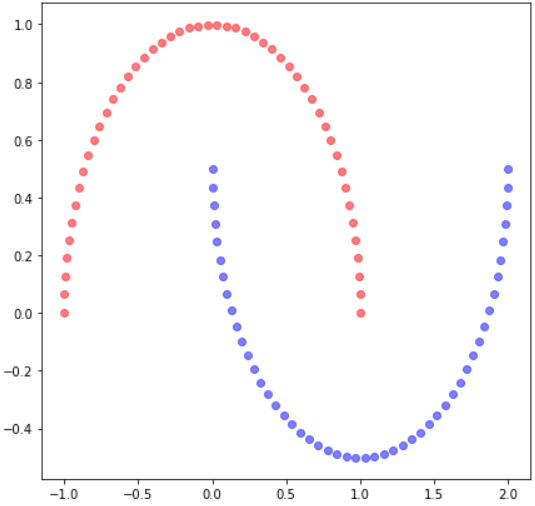

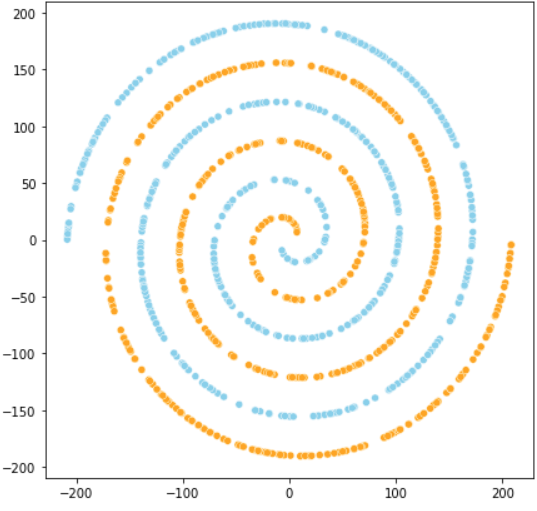

- 설명변수만을 가지고 다양한 데이터의 패턴을 잡아내어 클러스터를 구분해내거나 차원을 축소하는 것이 본 강의의 목적입니다.
- 비지도적 학습방법을 활용하여 데이터 생성시에 가정된 클러스터 정보와 최대한 비슷하게 클러스터를 구분해 내고자 하며, 이를 위하여 Principal Component를 활용합니다.


### **학습목표**
```
- 비지도학습의 개념을 이해.
- Principal Component에 대한 개념과 목적을 이해.
- 선형 패턴과 비선형 패턴의 차이와 이에 따른 접근방법 이해.
- 비선형 패턴 데이터를 다루기 위한 Kernel PCA 이해.
- 분석 상황에서의 Principal Componenet 활용.
``` 

##Step 5. Kernel PCA

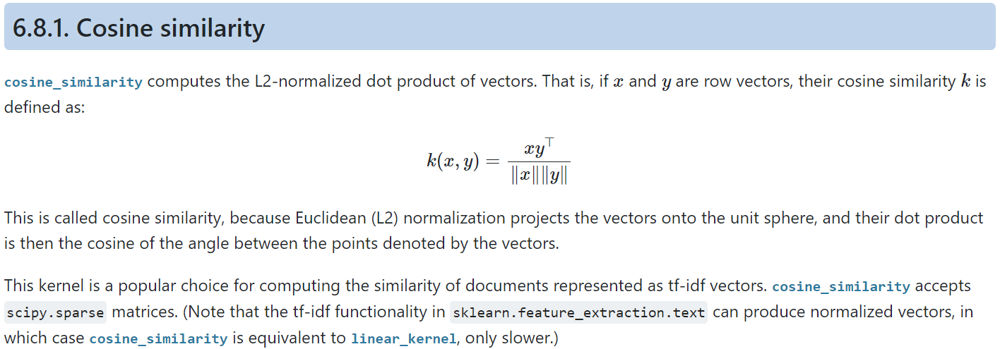

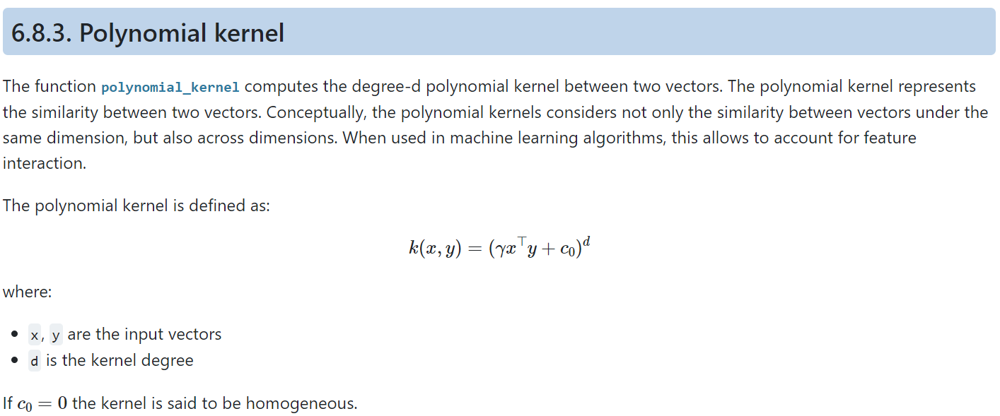

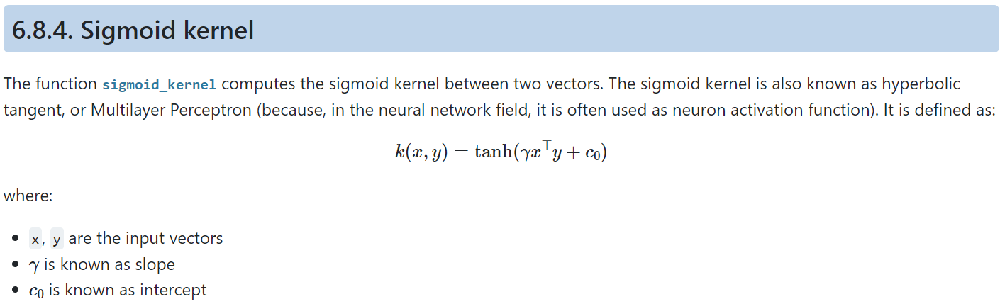

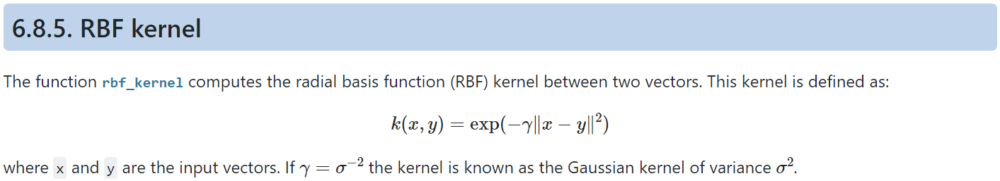

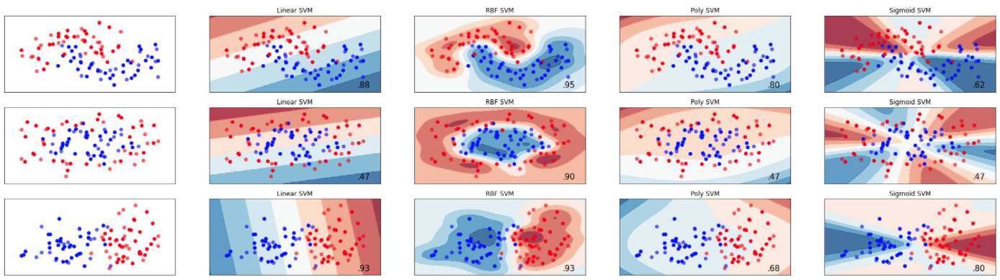

Image reference: https://scikit-learn.org/

https://www.geogebra.org/3d/evstbcjx




- Cosine : 크기보다 방향 유사도
- polynomial은 완만한 곡선에 대해서 비선형 분류를 진행해보고 싶을 때 (d = kernel degree 3~5) : 직선형이긴 한데 조금 구불구불
- -1 <= tanh <= 1 : Scale이 구간, 값이 아무리 커져도 특정값에 수렴, 이상치가 있어도 덜민감
- rbf 정규분포 가우시안 커널 : 비선형일 때 잘 작동(방사형 퍼진정도에 따라 값이 모두 같다)

### 문제 12. [Kernel PCA] Kernel PCA를 활용하여 비선형 패턴 구분해내기 (Concentric circles)

- Radial basis kernel (rbf) PCA로 진행.
  - Gaussian kernel PCA로도 불립니다.

In [ ]:
from sklearn.decomposition import KernelPCA

In [ ]:
np.arange(-50,50, 4)

array([-50, -46, -42, -38, -34, -30, -26, -22, -18, -14, -10,  -6,  -2,
         2,   6,  10,  14,  18,  22,  26,  30,  34,  38,  42,  46])

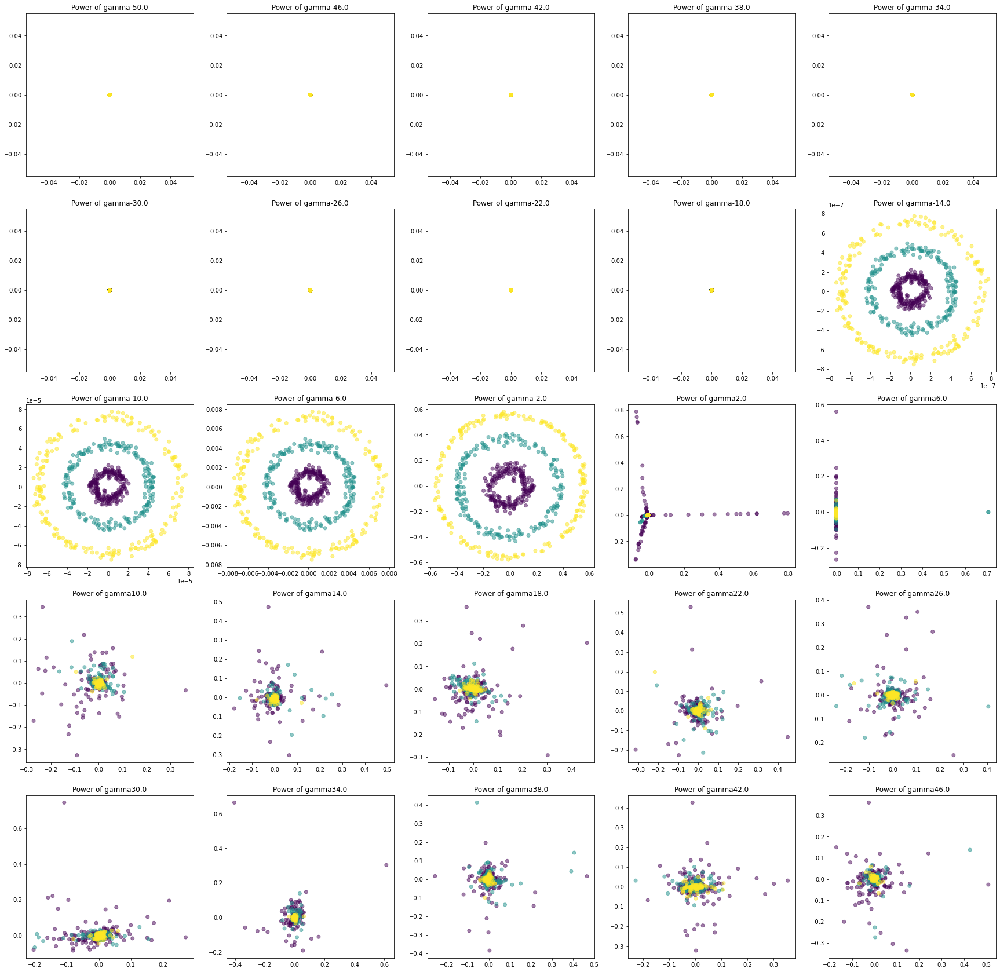

In [ ]:
## (문제)  데이터 X_2 (Concentric circles)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 rbf로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.

#gamma가 클수록 커널의 분산은 작아진다. 뾰족해진다. 작을수록 분산은 커진다. 2차원이랑 닮아가며, 커널PCA를 한 보람이 없다.

g_start=-50
g_end=50
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)



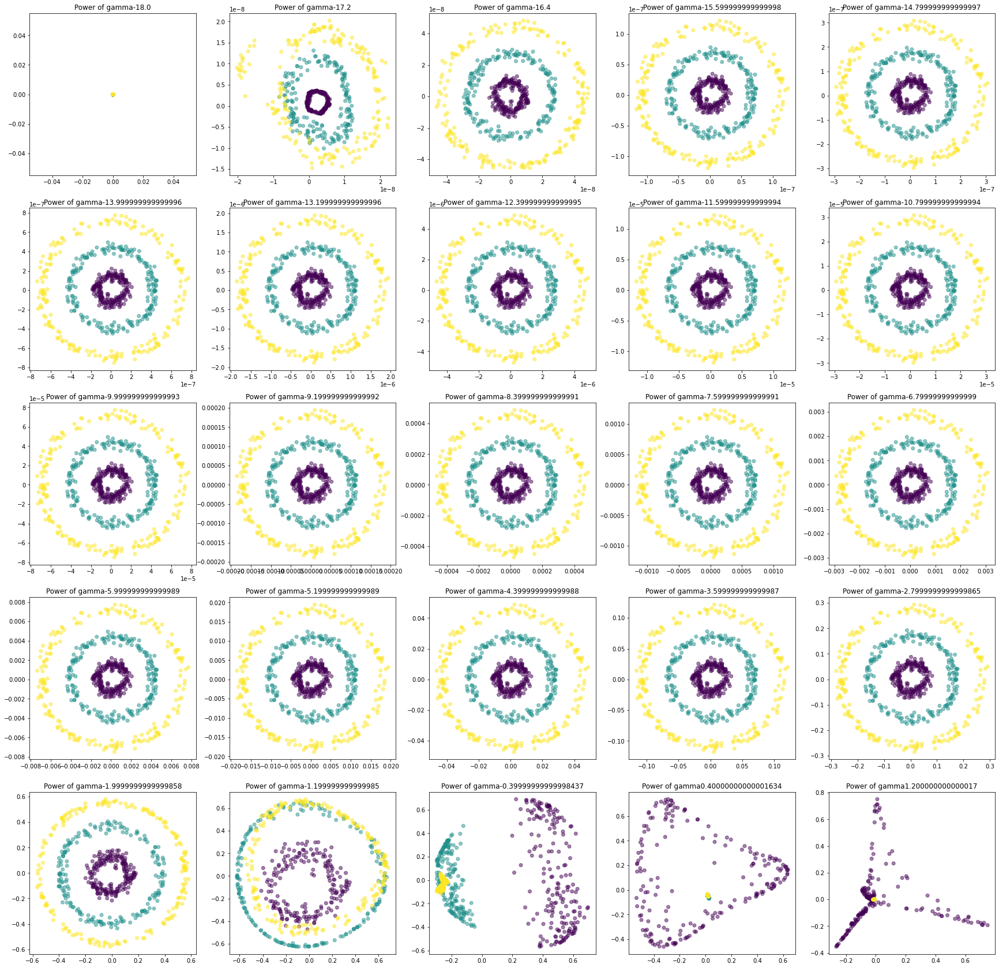

In [ ]:

g_start=-18
g_end=2
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)


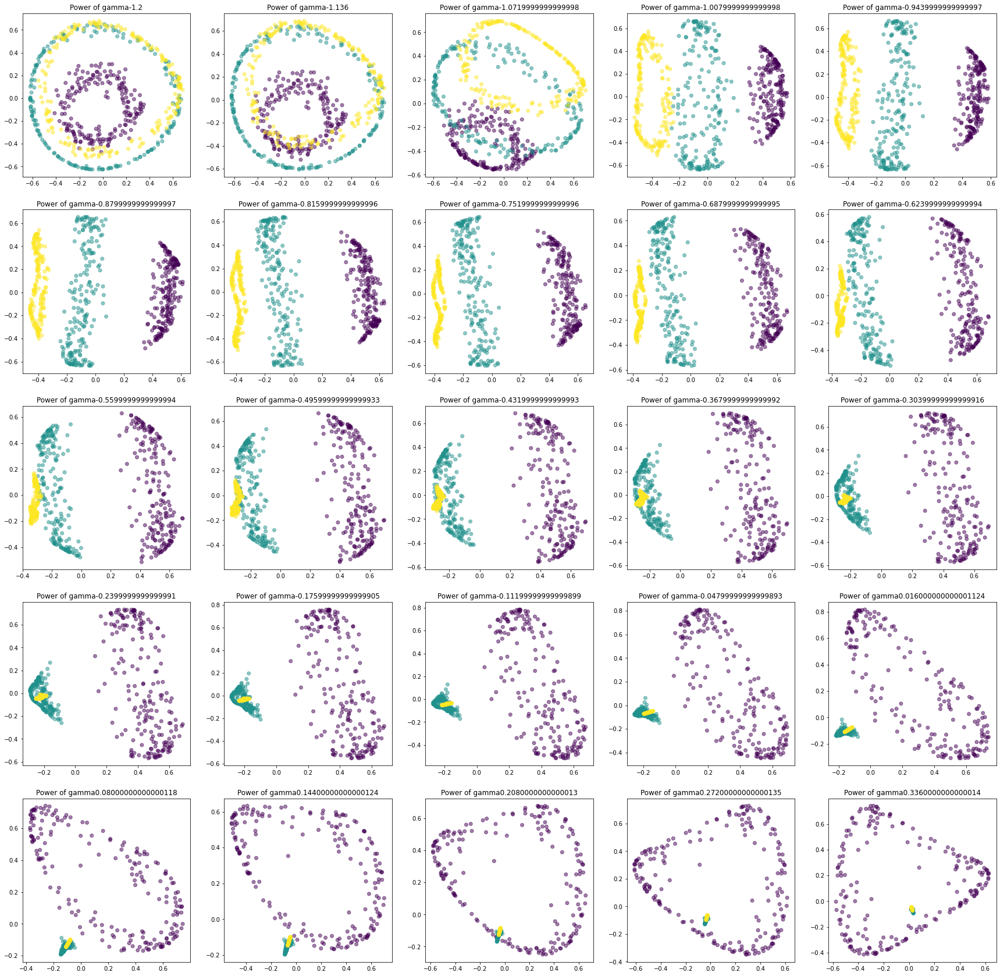

In [ ]:

g_start=-1.2
g_end=0.4
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)


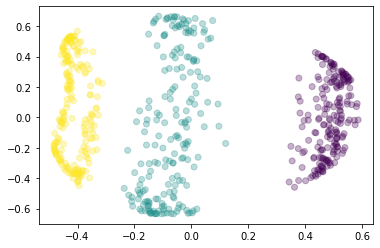

In [ ]:
## (문제) 적정한 Gamma를 결정하고 이를 바탕으로 플랏을 그립니다.

g_power_val=-0.94
g_value=10**g_power_val
scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
X_skernpca = scikit_kpca.fit_transform(X_2)

plt.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.3)
plt.show()

# 와우~ kernelPCA를 적절한 gamma 분산의 값으로 주성분 분석이 가능하구나, 
# 다음과 같이 특정 차원에서는 마치 선형처럼 분류되어 버리는 구나!

In [ ]:
from sklearn.cluster import KMeans

PC1_matrix=np.matrix(X_skernpca[:,0]).transpose()
km=KMeans(n_clusters=3,random_state=1)
km.fit(PC1_matrix)

y_km=km.labels_

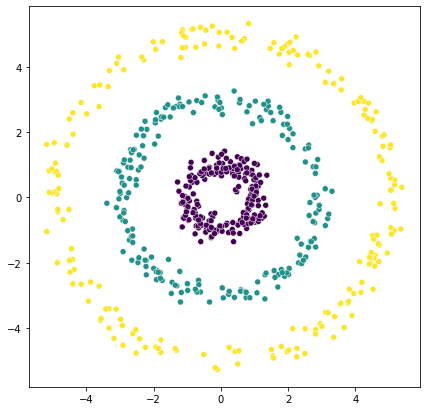

In [ ]:
plt.figure(figsize=(7,7))
sns.scatterplot(x=X_2[:,0],y=X_2[:,1],c=y_km)
plt.show()

#rbf가 비선형 데이터에 대해 주성분 분석 성능이 확실히 뛰어나네!

- Polynomial kernel PCA로 진행.

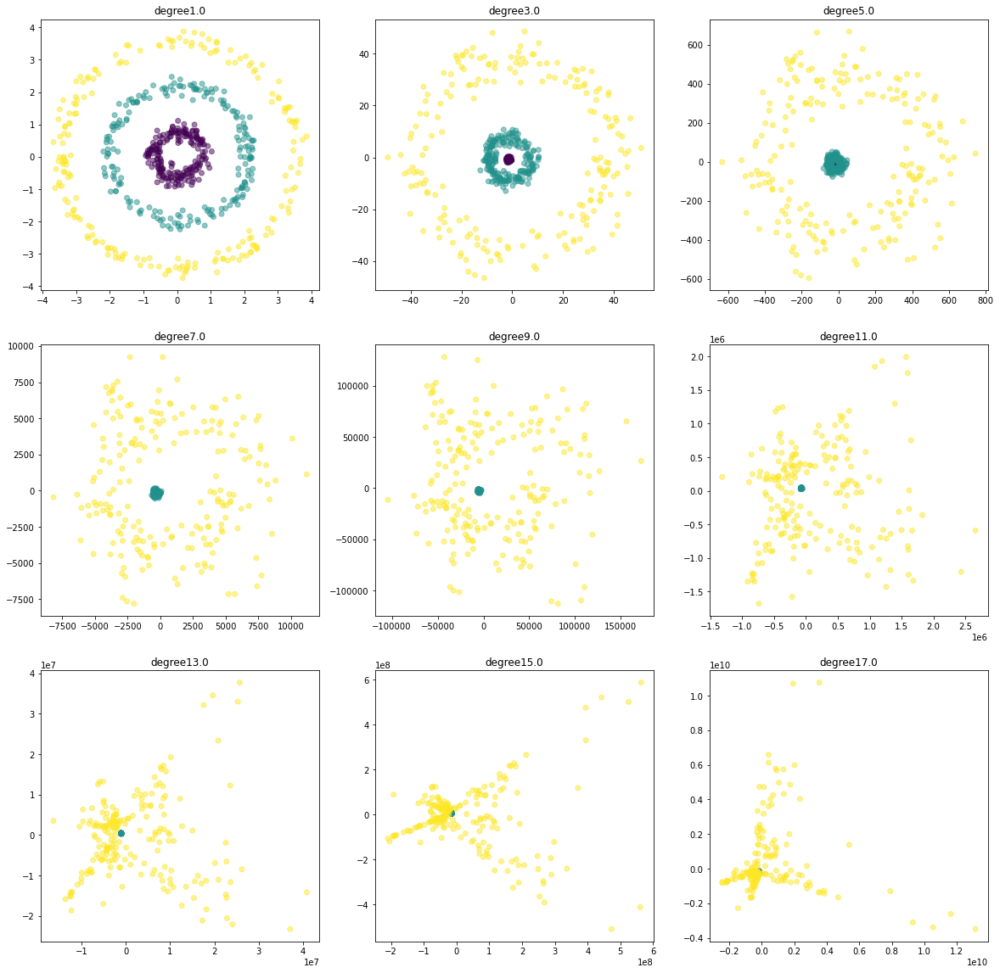

In [ ]:
## (문제)  데이터 X_2 (Concentric circles)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 poly로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 degree 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 degree 값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 degree에 대하여 고민해봅니다.
# 본 과정은 degree의 범위를 좁혀가며 여러번 진행될 수 있습니다.
# 적정 degree를 찾았다면, gamma, coef0에 대해서도 마찬가지로 진행합니다.

g_start=1
g_end=19
g_power = np.arange(g_start,g_end, (g_end-g_start)/9)

fig, axs = plt.subplots(nrows=3,ncols=3,figsize=(20,20),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='poly',degree=g_power[n])
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('degree'+str(g_power[n]),size=12)

# 너무 비선형 데이터이기 때문에, 직선을 살짝 완만하게 구부리는 정도의 polynominal로는 분류가 잘 안되는 구나!

- Sigmoid kernel PCA로 진행.

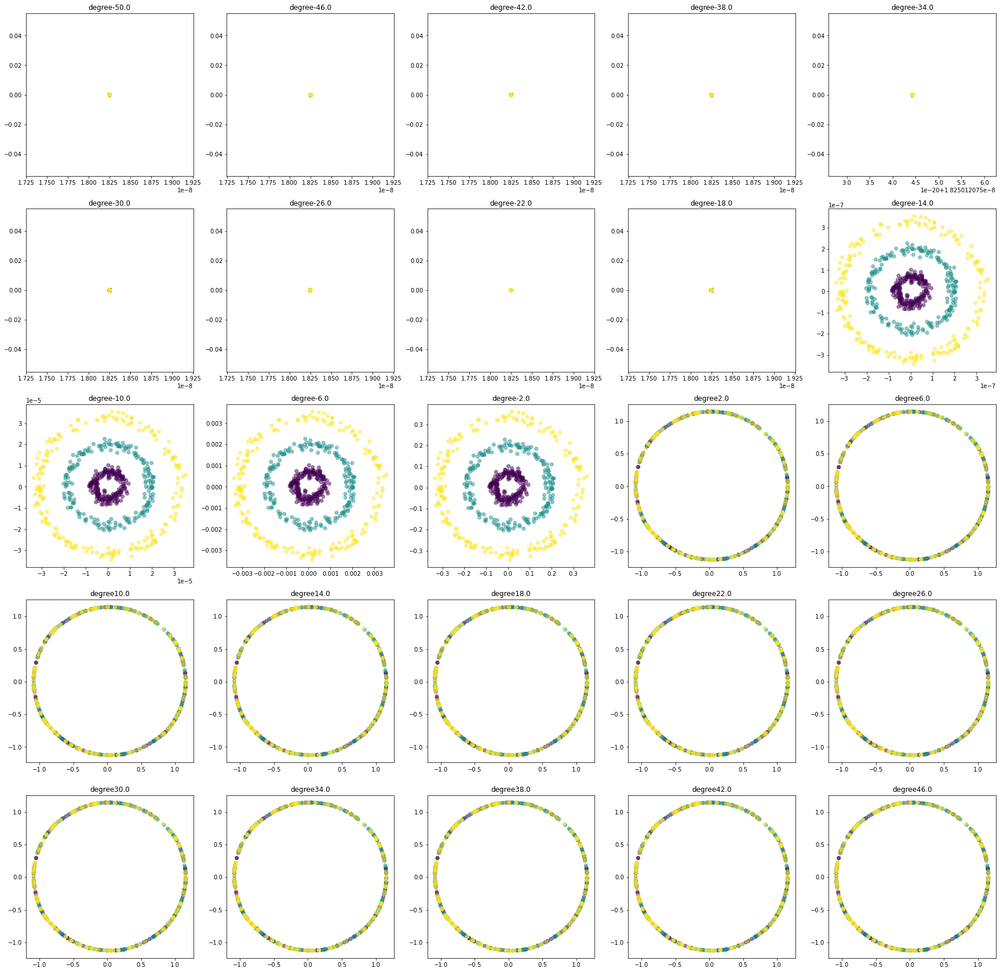

In [ ]:
## (문제)  데이터 X_2 (Concentric circles)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 sigmoid 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma 값에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.
# 적정 gamma를 찾을 수 있었다면 coef0에 대해서도 마찬가지로 진행합니다.
g_start = -50
g_end= 50
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate (axs.flatten()):
  g_value=10**(g_power[n])
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('degree'+str(g_power[n]),size=12)
  
plt.show()

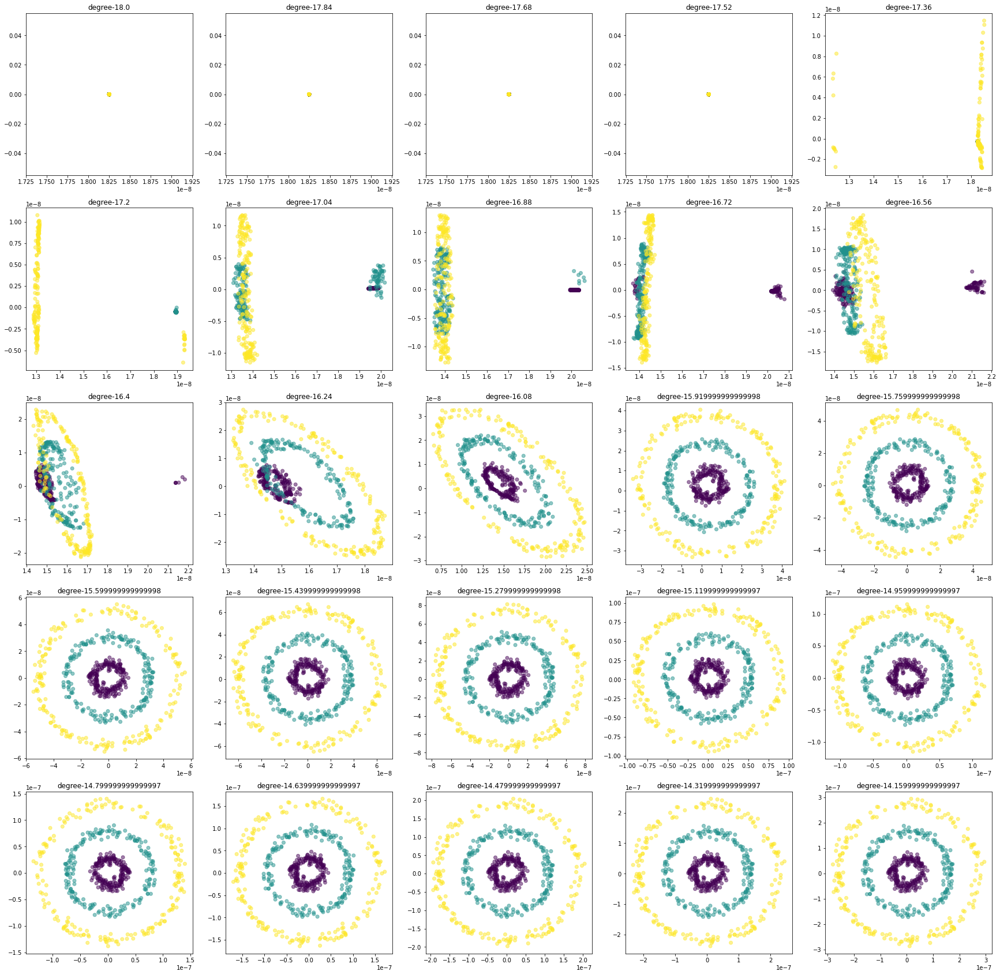

In [ ]:

g_start = -18
g_end= -14
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate (axs.flatten()):
  g_value=10**(g_power[n])
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('degree'+str(g_power[n]),size=12)
  
plt.show()

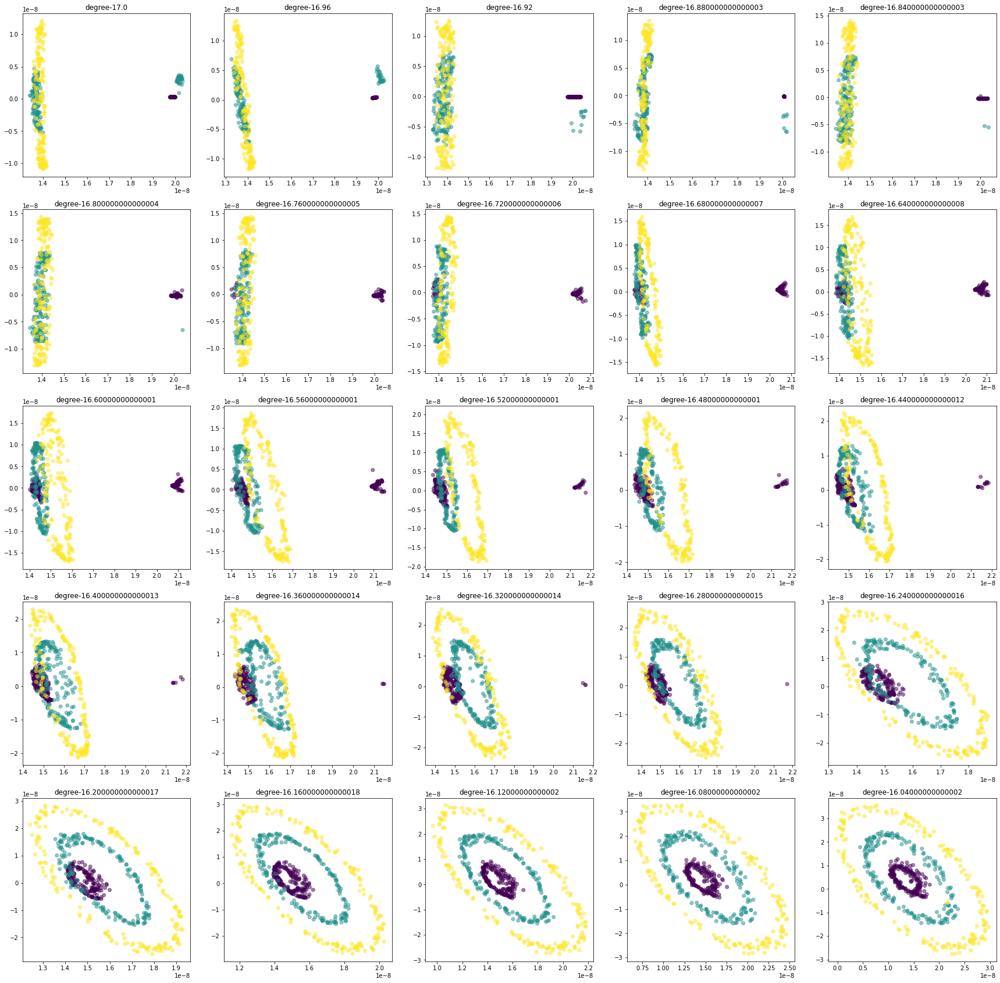

In [ ]:

g_start = -17
g_end= -16
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate (axs.flatten()):
  g_value=10**(g_power[n])
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('degree'+str(g_power[n]),size=12)
  
plt.show()

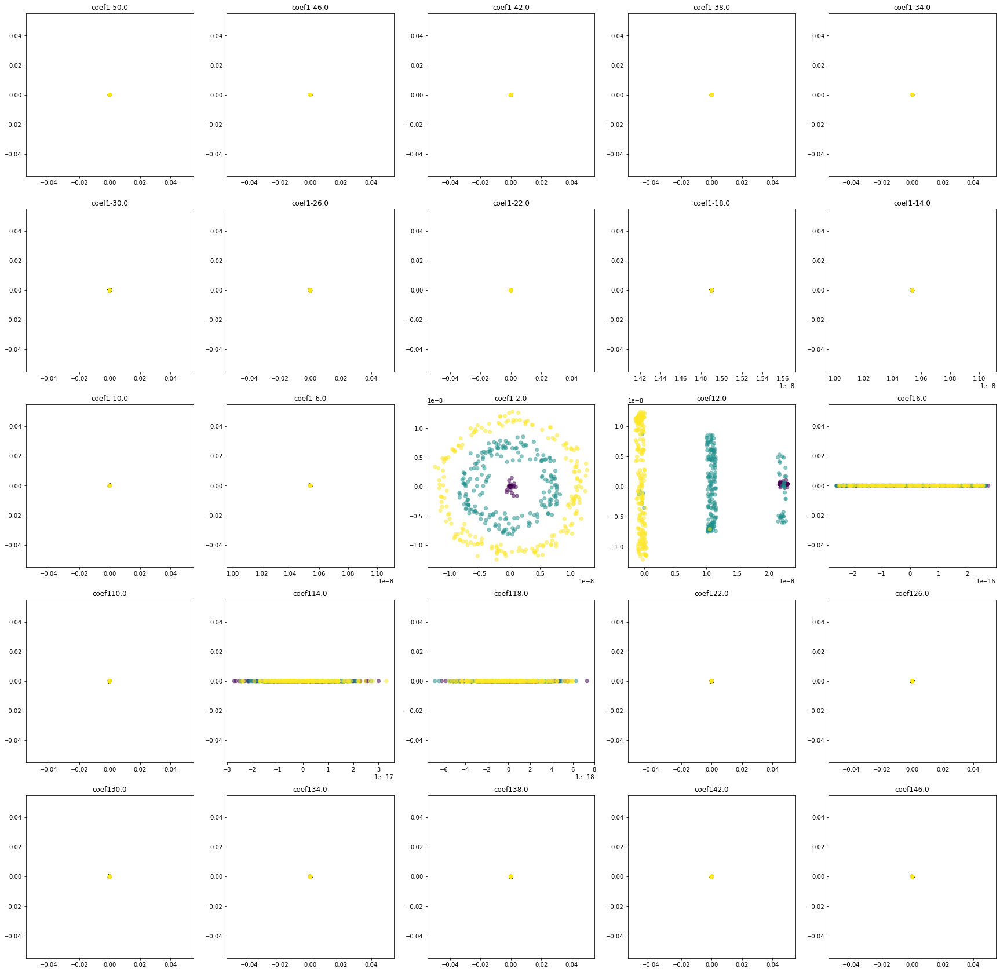

In [ ]:

g_start = -50
g_end= 50
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate (axs.flatten()):
  g_value=10**(-16.096)
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value,coef0=g_power[n])
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('coef1'+str(g_power[n]),size=12)
  
plt.show()

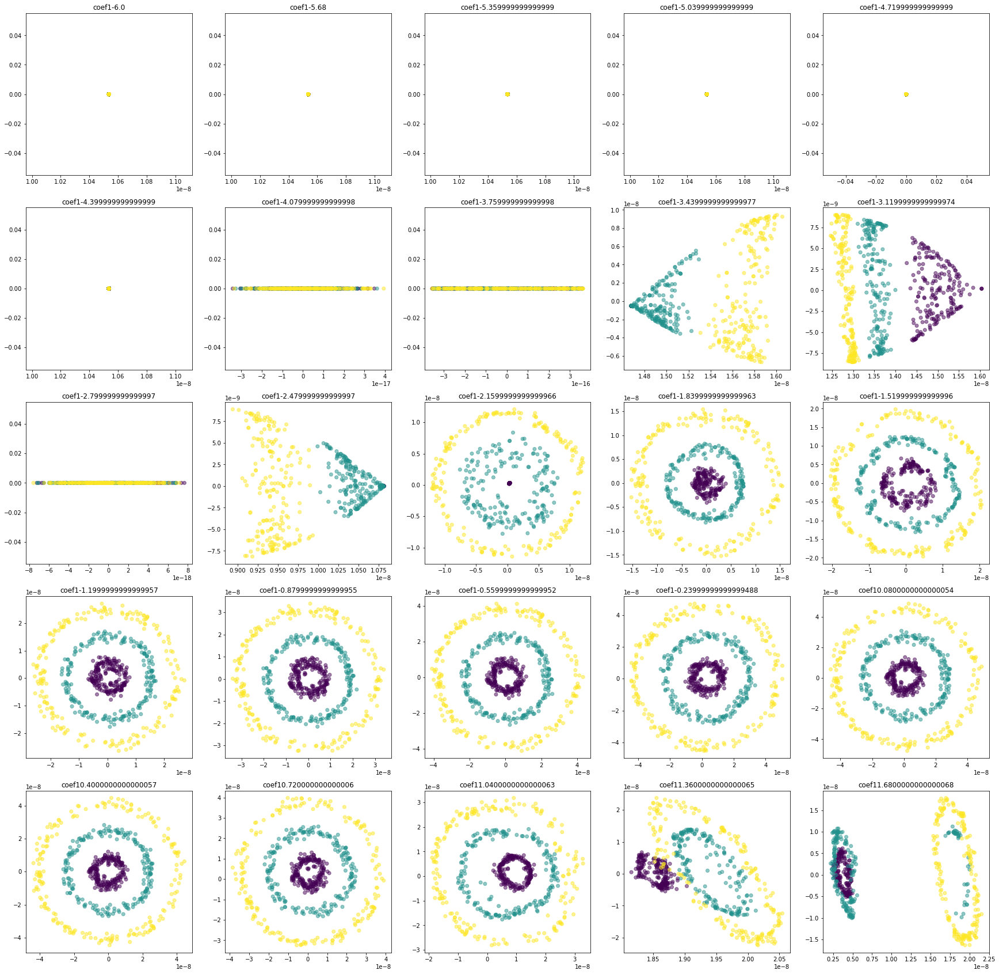

In [ ]:

g_start = -6
g_end= 2
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate (axs.flatten()):
  g_value=10**(-16.096)
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value,coef0=g_power[n])
  X_skernpca = scikit_kpca.fit_transform(X_2)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
  ax.set_title('coef1'+str(g_power[n]),size=12)
  
plt.show()

In [ ]:
g_power

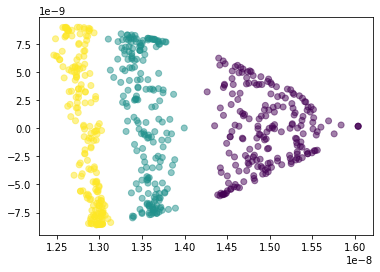

In [ ]:

g_value=10**(-16.096)
scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value,coef0=g_power[9])
X_skernpca = scikit_kpca.fit_transform(X_2)
plt.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_2,alpha=0.5)
plt.show()

In [ ]:
from sklearn.cluster import KMeans

PC1_matrix=np.matrix(X_skernpca[:,0]).transpose()
km=KMeans(n_clusters=3,random_state=1)
km.fit(PC1_matrix)

y_km=km.labels_

#kernelPCA(kernel='sigmoid')로 비선형 데이터를 잘 나눌 수 있는 주성분 하나를 찾았고,

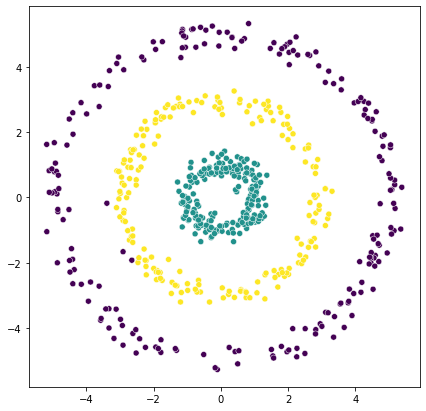

In [ ]:
plt.figure(figsize=(7,7))
sns.scatterplot(x=X_2[:,0],y=X_2[:,1],c=y_km)
plt.show()

#그려보니, 정말 잘 나눠지더라!

### 문제 13. [Kernel PCA] Kernel PCA를 활용하여 비선형 패턴 구분해내기 (Interleaving half circles)


- Radial basis kernel (rbf) PCA로 진행.

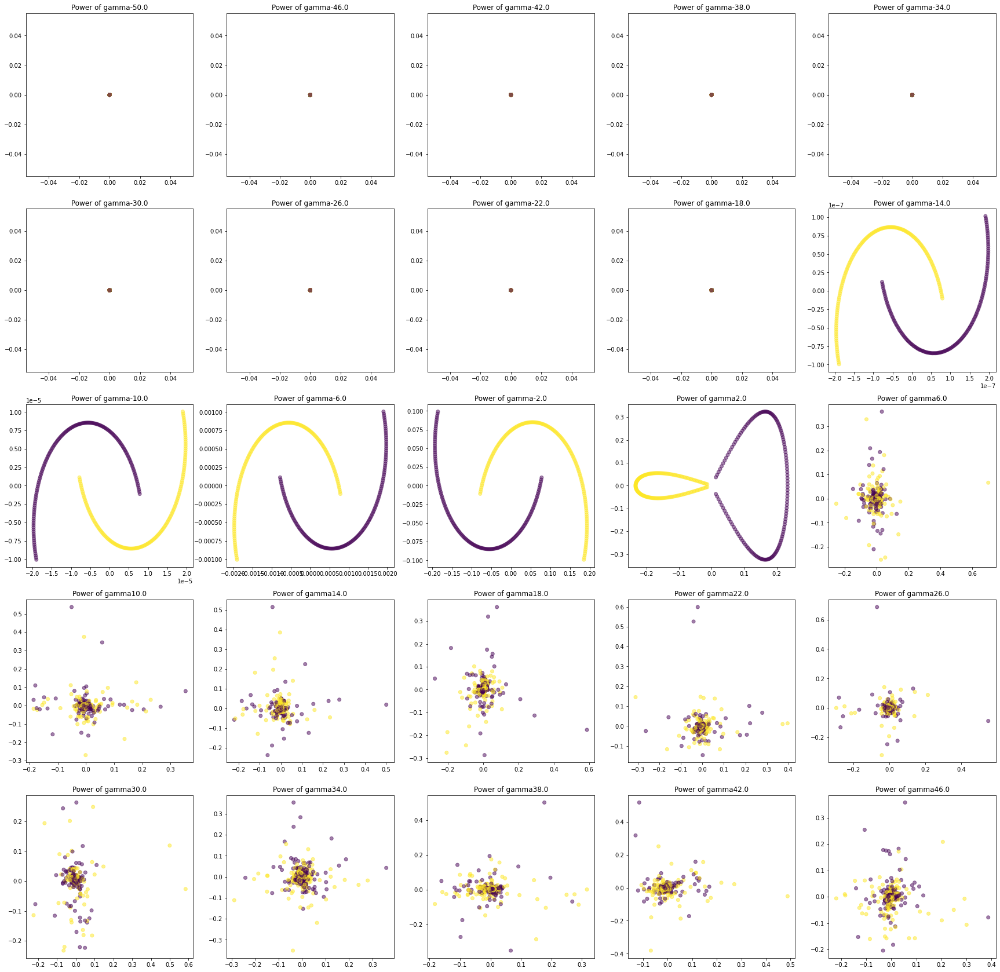

In [16]:
## (문제)  데이터 X_3 (Interleaving half circles)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 rbf로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.

from sklearn.decomposition import KernelPCA

g_start=-50
g_end=50
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)

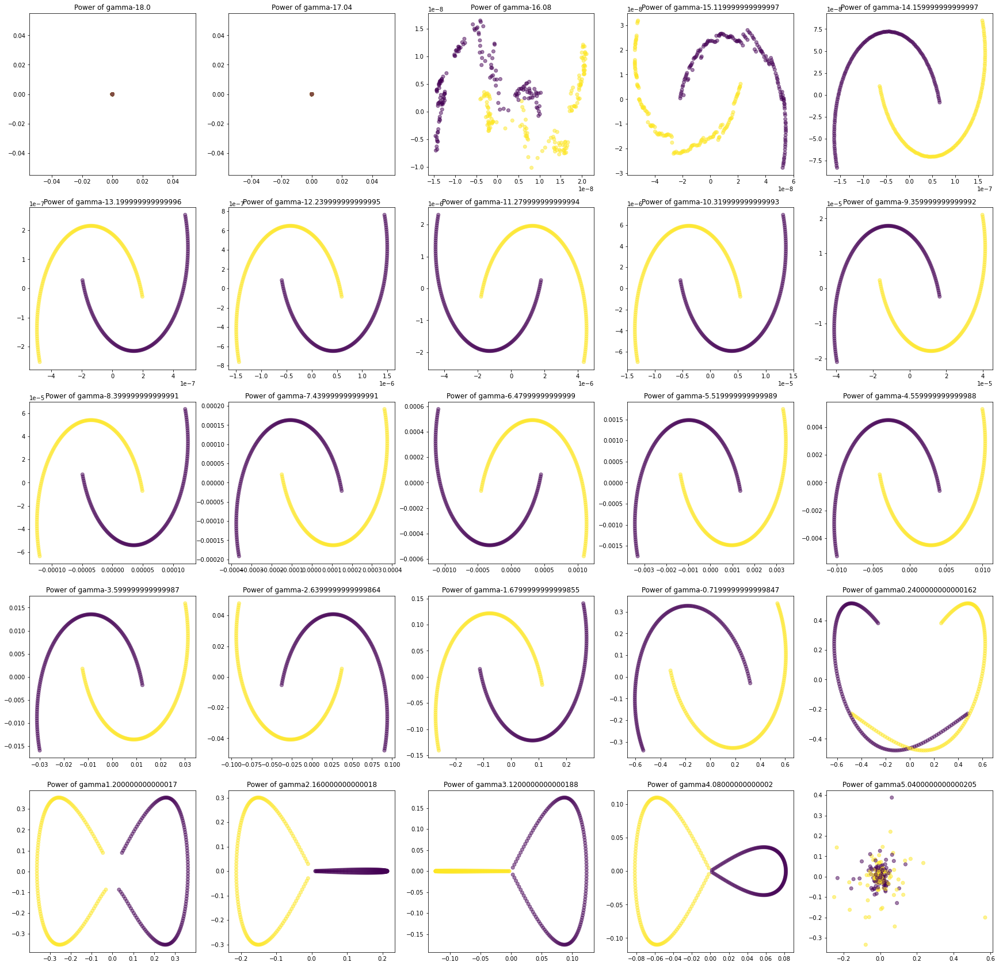

In [17]:

g_start=-18
g_end=6
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)

In [28]:
g_power[20]

1.200000000000017

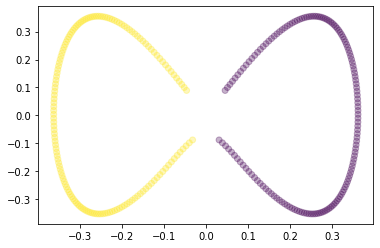

In [25]:
# g_power_val=1.2
g_value=10**g_power[20]
scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
X_skernpca = scikit_kpca.fit_transform(X_3)

plt.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.3)
plt.show()

In [26]:
from sklearn.cluster import KMeans

PC3_matrix=np.matrix(X_skernpca[:,0]).transpose()
km=KMeans(n_clusters=3,random_state=1)
km.fit(PC3_matrix)

y_km=km.labels_

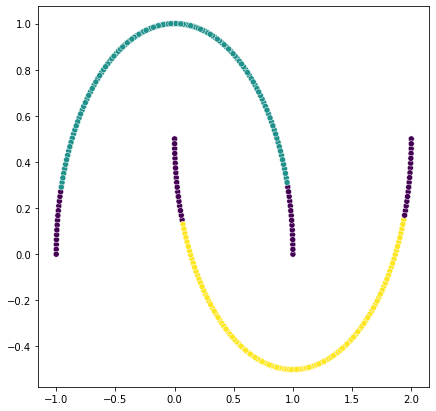

In [27]:
plt.figure(figsize=(7,7))
sns.scatterplot(x=X_3[:,0],y=X_3[:,1],c=y_km)
plt.show()


- Polynomial kernel PCA로 진행.

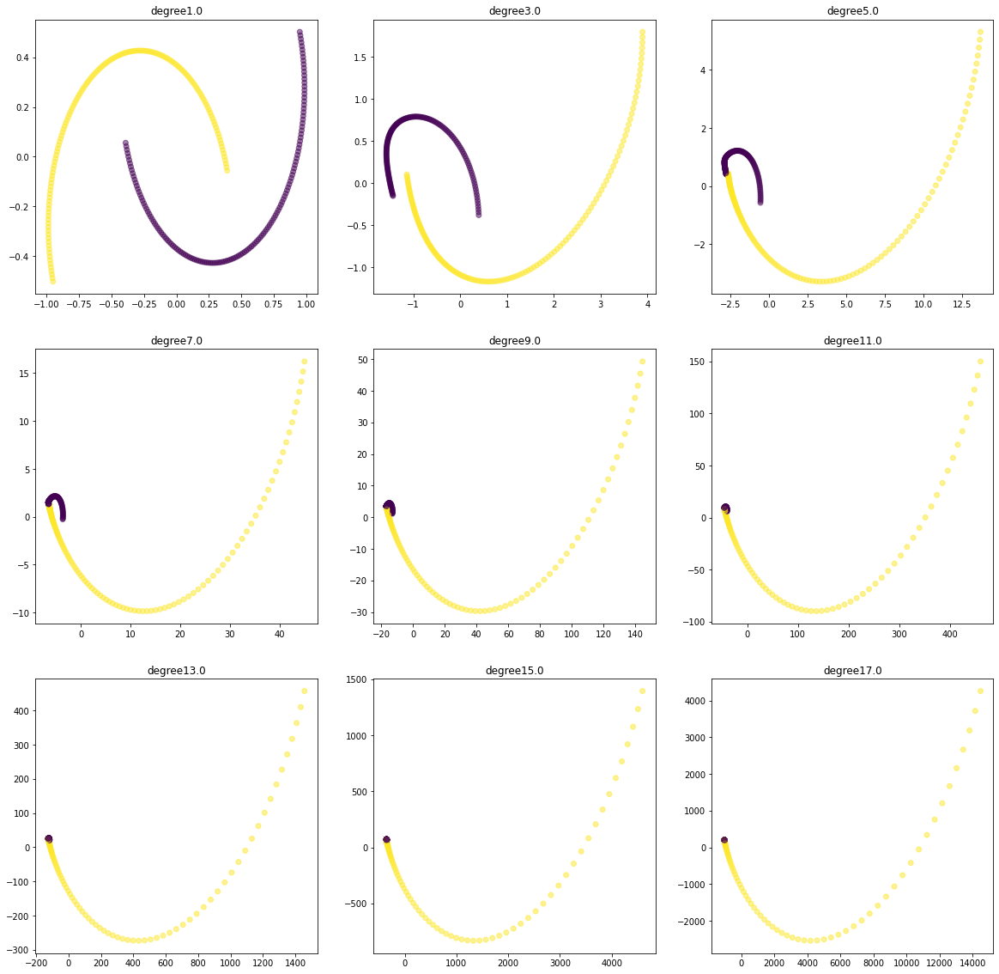

In [29]:
## (문제)  데이터 X_3 (Interleaving half circles)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 poly로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 degree 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 degree 값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 degree에 대하여 고민해봅니다.
# 본 과정은 degree의 범위를 좁혀가며 여러번 진행될 수 있습니다.
# 적정 degree를 찾았다면, gamma, coef0에 대해서도 마찬가지로 진행합니다.

g_start=1
g_end=19
g_power = np.arange(g_start,g_end, (g_end-g_start)/9)

fig, axs = plt.subplots(nrows=3,ncols=3,figsize=(20,20),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='poly',degree=g_power[n])
  X_skernpca = scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title('degree'+str(g_power[n]),size=12)

- Sigmoid kernel PCA로 진행.

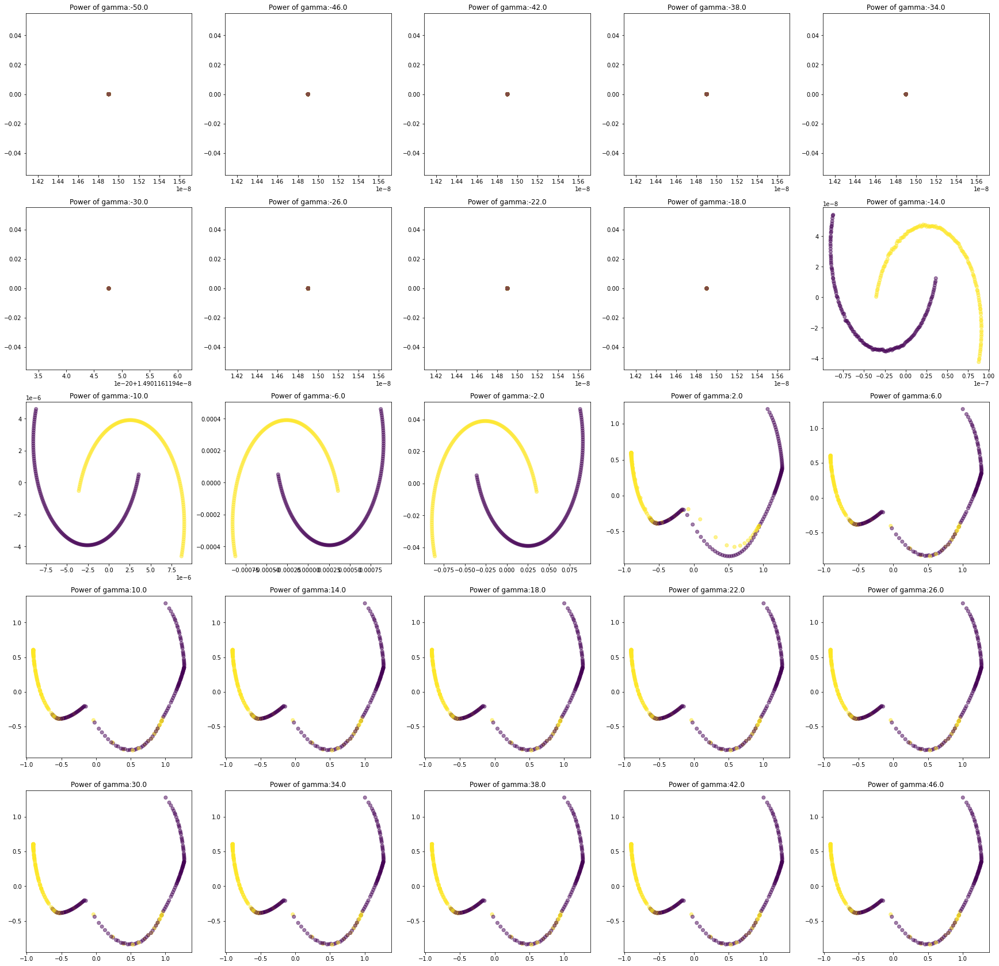

In [30]:
## (문제)  데이터 X_3 (Interleaving half circles)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 sigmoid 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma 값에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.
# 적정 gamma를 찾을 수 있었다면 coef0에 대해서도 마찬가지로 진행합니다.


g_start=-50
g_end=50
g_power=np.arange(g_start,g_end,(g_end-g_start)/25)

fig,axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n , ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title("Power of gamma:" + str(g_power[n]))



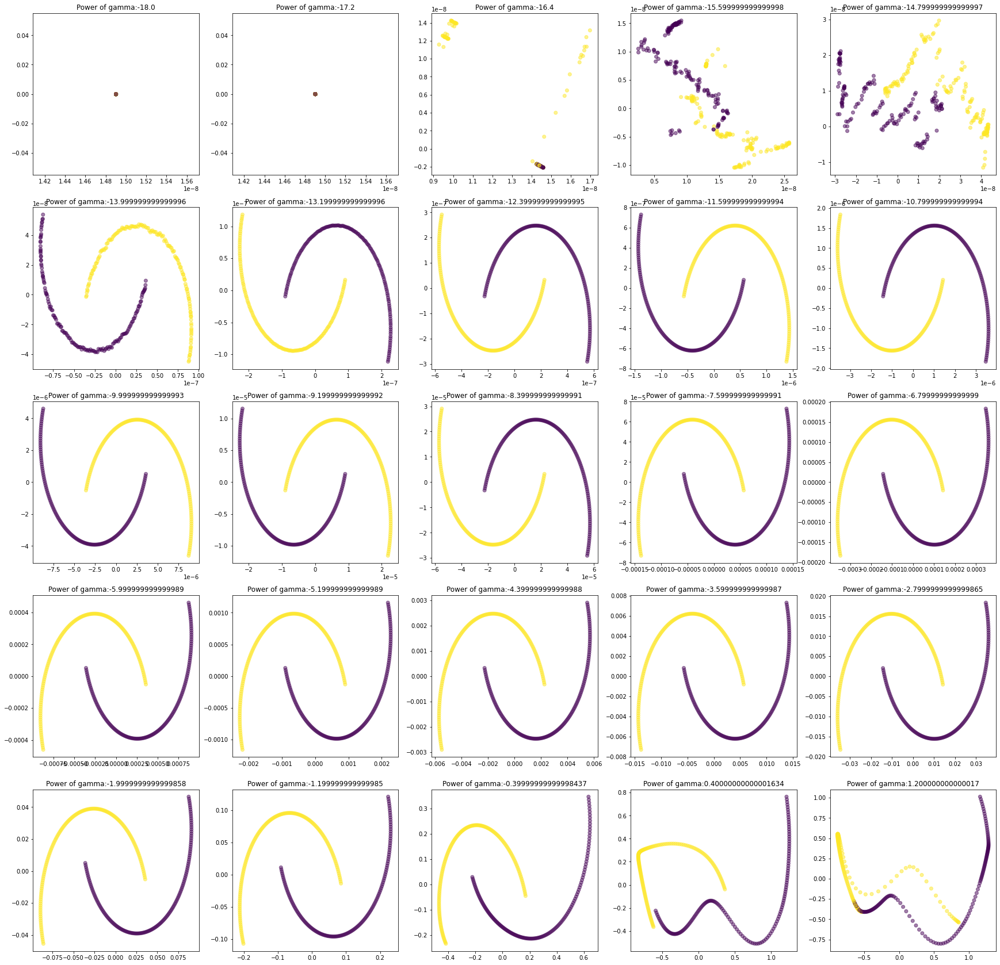

In [31]:

g_start=-18
g_end=2
g_power=np.arange(g_start,g_end,(g_end-g_start)/25)

fig,axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n , ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title("Power of gamma:" + str(g_power[n]))



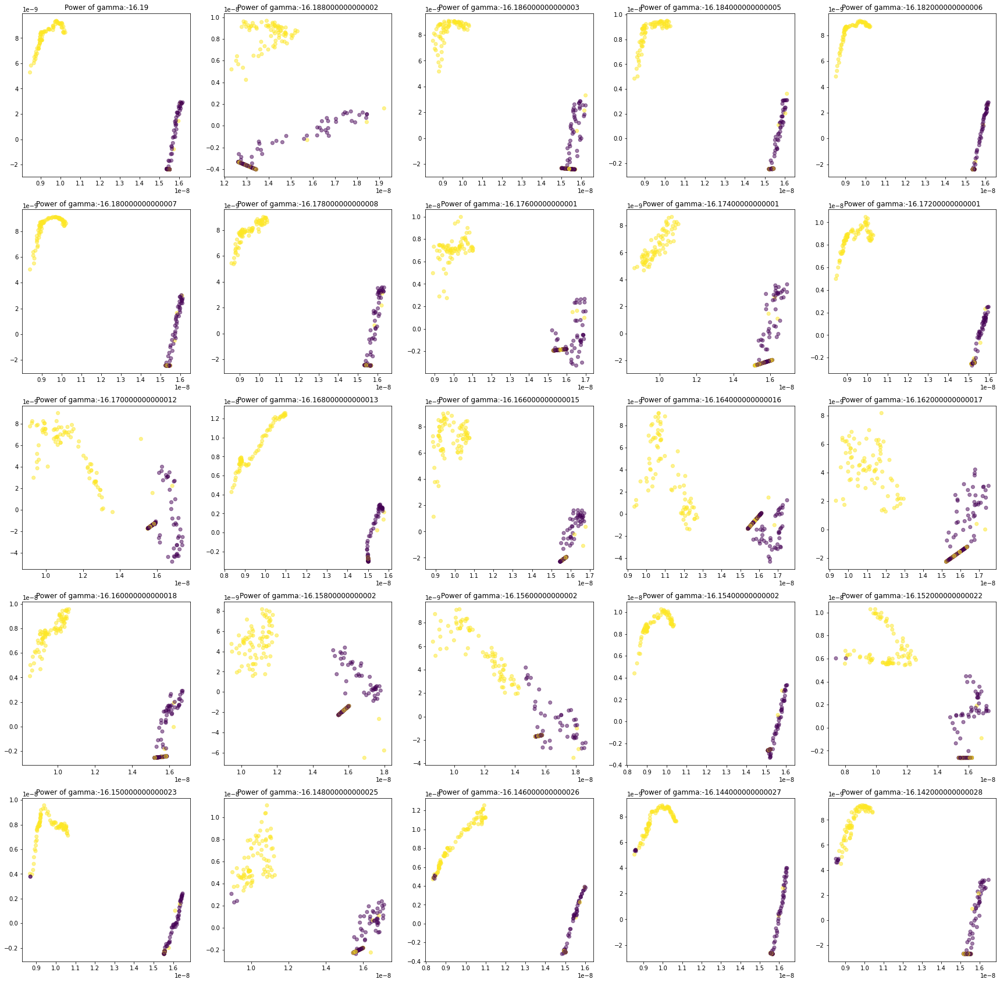

In [34]:

g_start=-16.19
g_end=-16.14
g_power=np.arange(g_start,g_end,(g_end-g_start)/25)

fig,axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n , ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title("Power of gamma:" + str(g_power[n]))



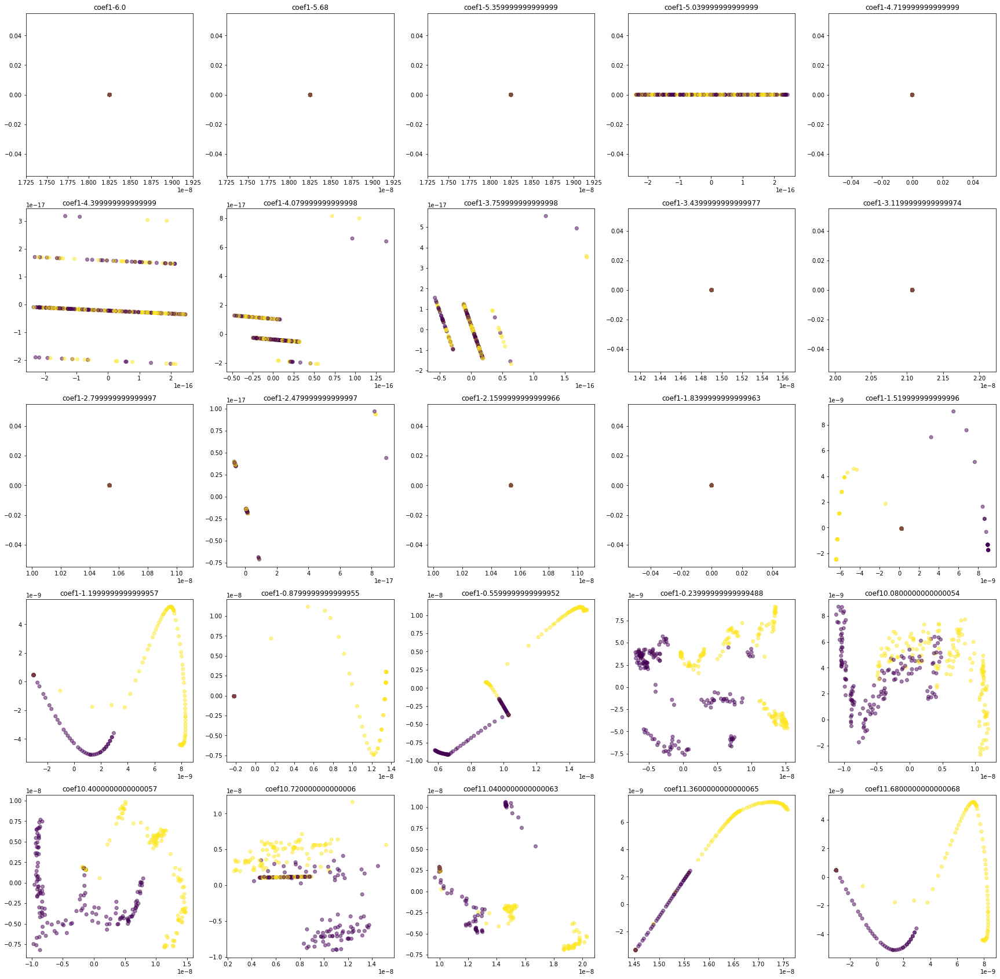

In [36]:
g_start = -6
g_end= 2
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate (axs.flatten()):
  g_value=10**(-16.18)
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value,coef0=g_power[n])
  X_skernpca = scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title('coef1'+str(g_power[n]),size=12)
  
plt.show()

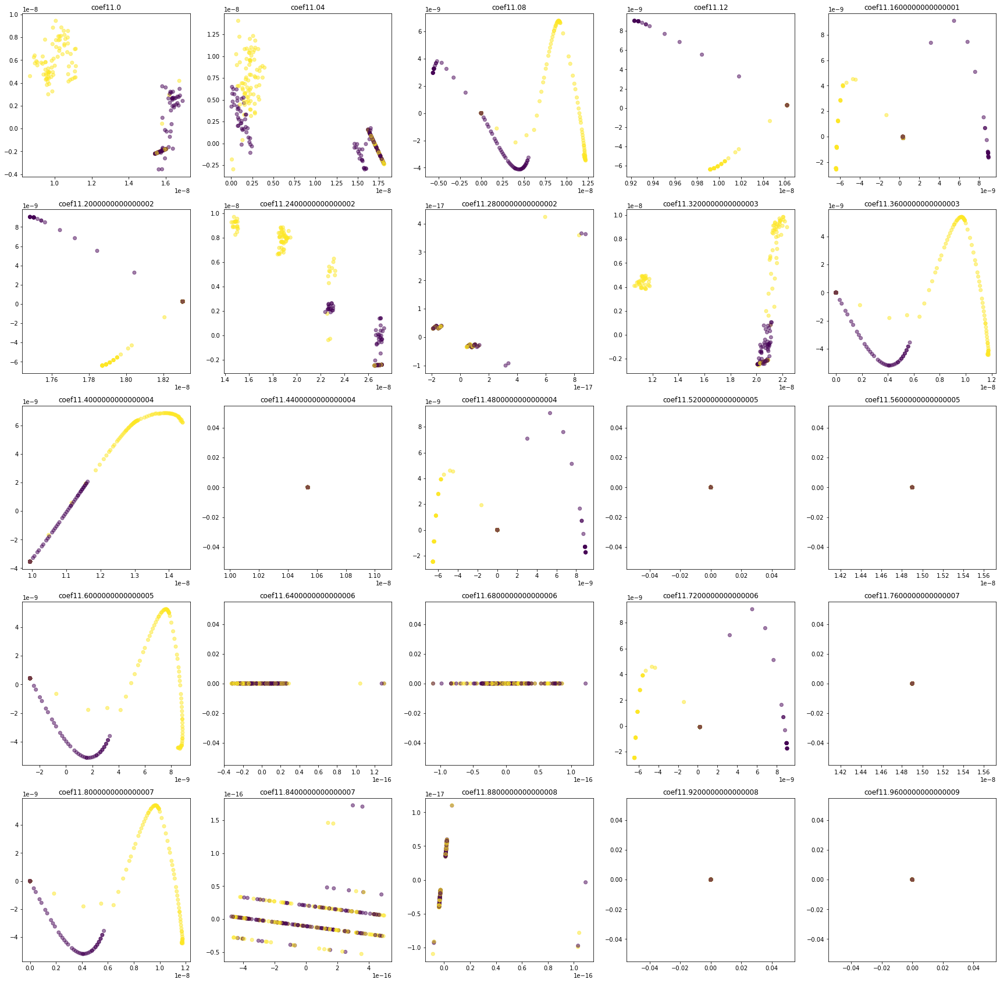

In [37]:
g_start = 1
g_end= 2
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate (axs.flatten()):
  g_value=10**(-16.18)
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value,coef0=g_power[n])
  X_skernpca = scikit_kpca.fit_transform(X_3)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
  ax.set_title('coef1'+str(g_power[n]),size=12)
  
plt.show()

In [38]:
g_power[10]

1.4000000000000004

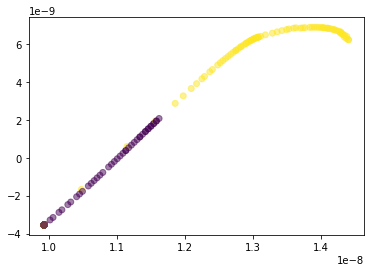

In [39]:
g_value=10**(-16.18)
scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value,coef0=g_power[10])
X_skernpca = scikit_kpca.fit_transform(X_3)
plt.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_3,alpha=0.5)
plt.show()

In [40]:
from sklearn.cluster import KMeans

PC3_matrix=np.matrix(X_skernpca[:,0]).transpose()
km=KMeans(n_clusters=3,random_state=1)
km.fit(PC3_matrix)

y_km=km.labels_

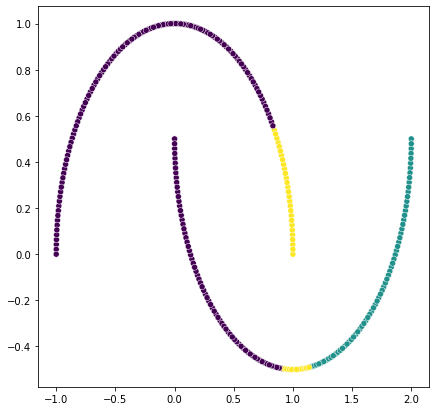

In [41]:
plt.figure(figsize=(7,7))
sns.scatterplot(x=X_3[:,0],y=X_3[:,1],c=y_km)
plt.show()


### 문제 14. [Kernel PCA] Kernel PCA를 활용하여 비선형 패턴 구분해내기 (Spiral)

- Spiral의 경우는 완벽하게 구분되지 않을 수 있습니다.

- Radial basis kernel (rbf) PCA로 진행.

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:530: RuntimeWarning:

invalid value encountered in multiply

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:530: RuntimeWarning:

invalid value encountered in multiply



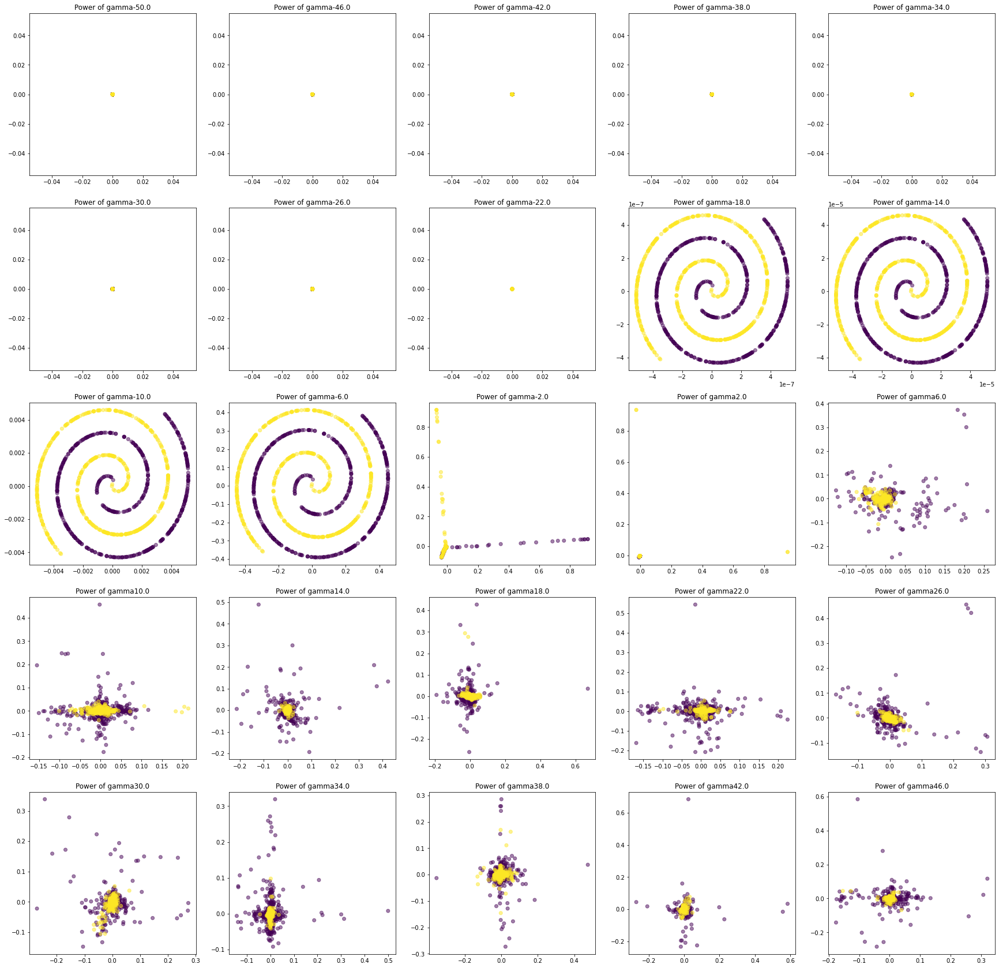

In [42]:
## (문제)  데이터 X_4 (Spiral)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 rbf로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.

g_start=-50
g_end=50
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_4)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_4,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)

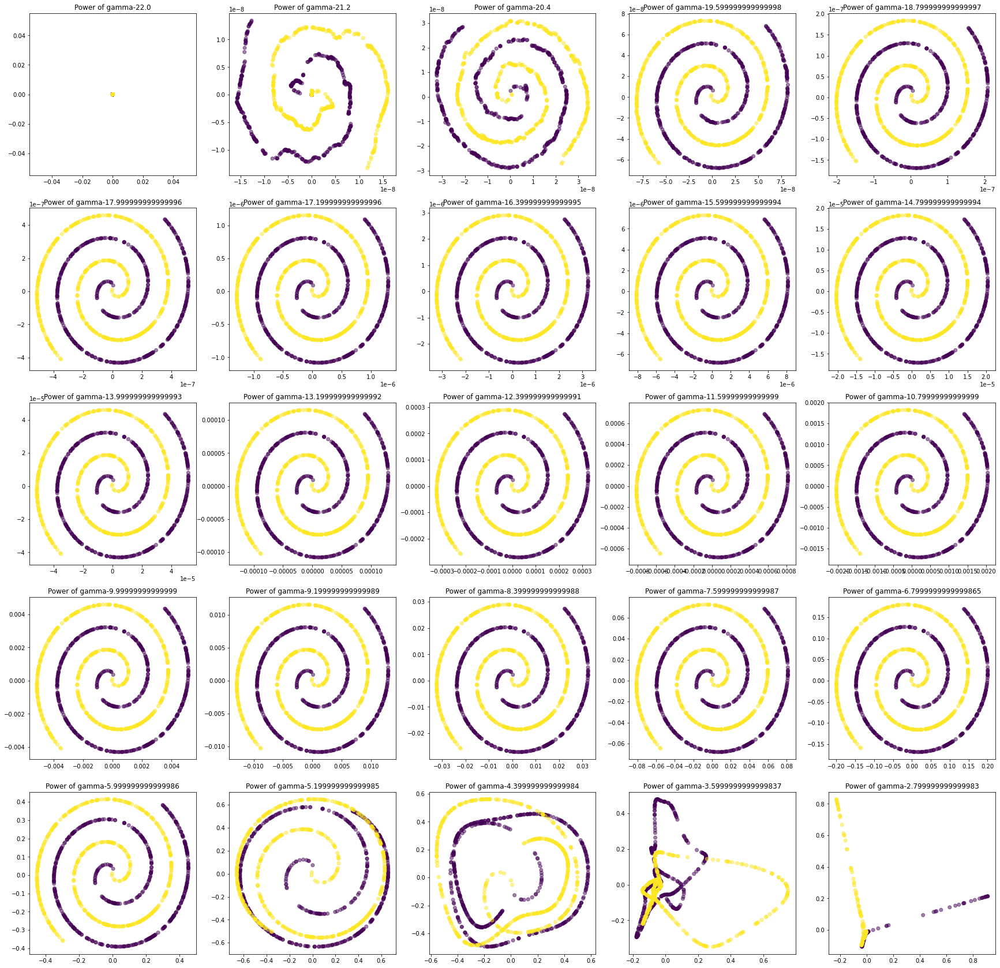

In [43]:

g_start=-22
g_end=-2
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_4)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_4,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)

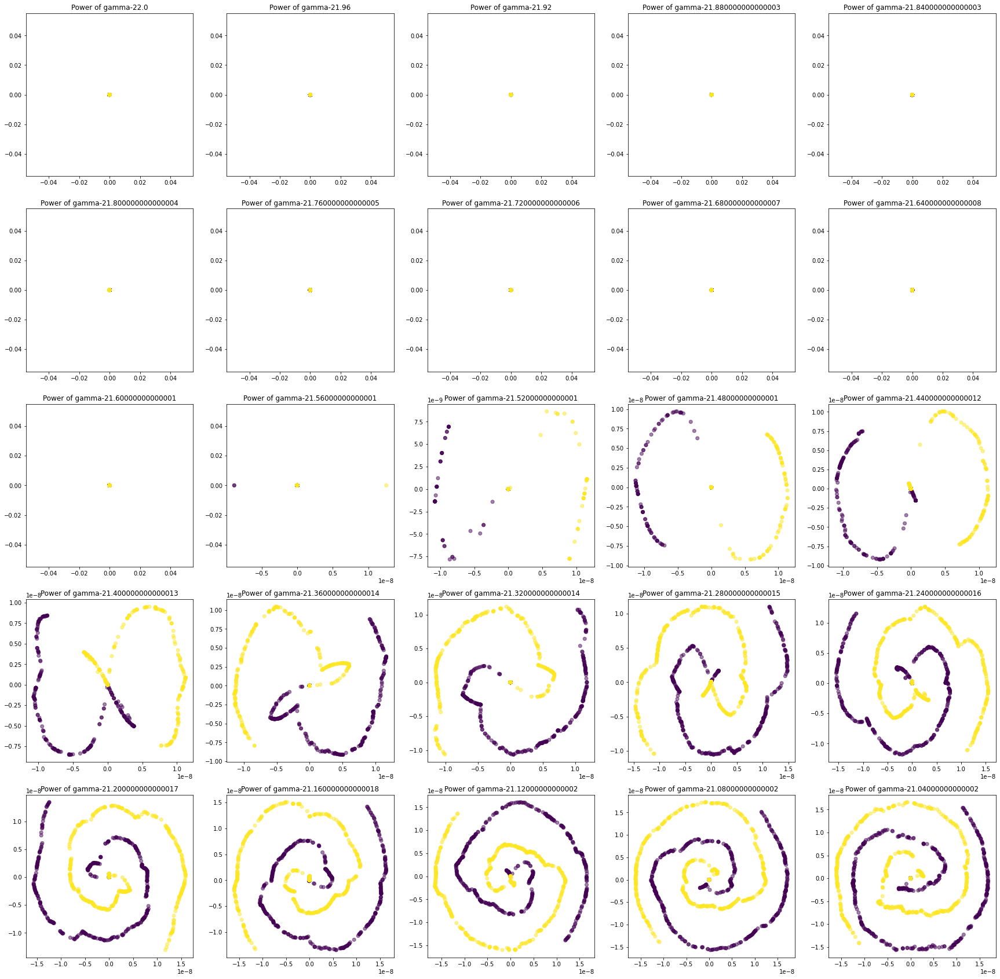

In [44]:

g_start=-22
g_end=-21
g_power = np.arange(g_start,g_end, (g_end-g_start)/25)

fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca = scikit_kpca.fit_transform(X_4)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_4,alpha=0.5)
  ax.set_title('Power of gamma'+str(g_power[n]),size=12)

- Polynomial kernel PCA로 진행.

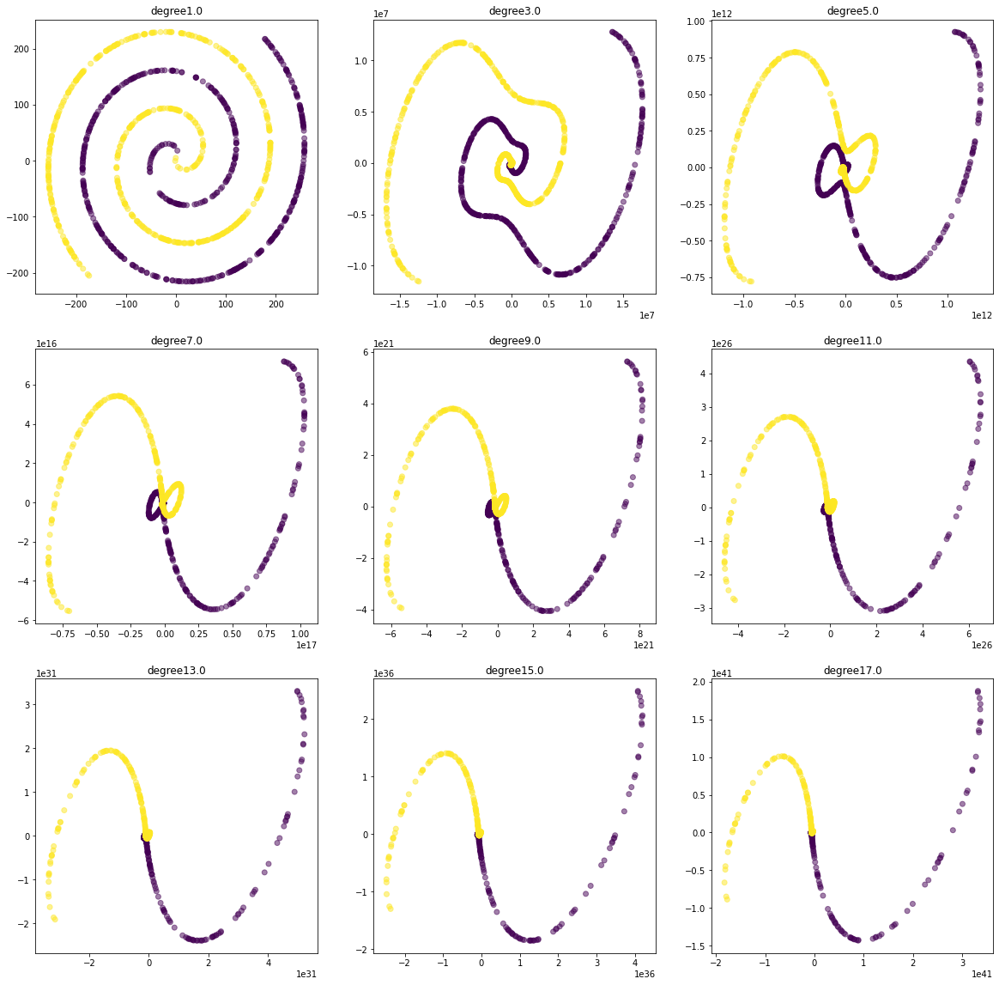

In [45]:
## (문제)  데이터 X_4 (Spiral)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 poly로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 degree 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 degree 값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 degree에 대하여 고민해봅니다.
# 본 과정은 degree의 범위를 좁혀가며 여러번 진행될 수 있습니다.
# 적정 degree를 찾았다면, gamma, coef0에 대해서도 마찬가지로 진행합니다.


g_start=1
g_end=19
g_power = np.arange(g_start,g_end, (g_end-g_start)/9)

fig, axs = plt.subplots(nrows=3,ncols=3,figsize=(20,20),sharex=False,sharey=False)

for n, ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='poly',degree=g_power[n])
  X_skernpca = scikit_kpca.fit_transform(X_4)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_4,alpha=0.5)
  ax.set_title('degree'+str(g_power[n]),size=12)

- Sigmoid kernel PCA로 진행.

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:530: RuntimeWarning:

invalid value encountered in multiply



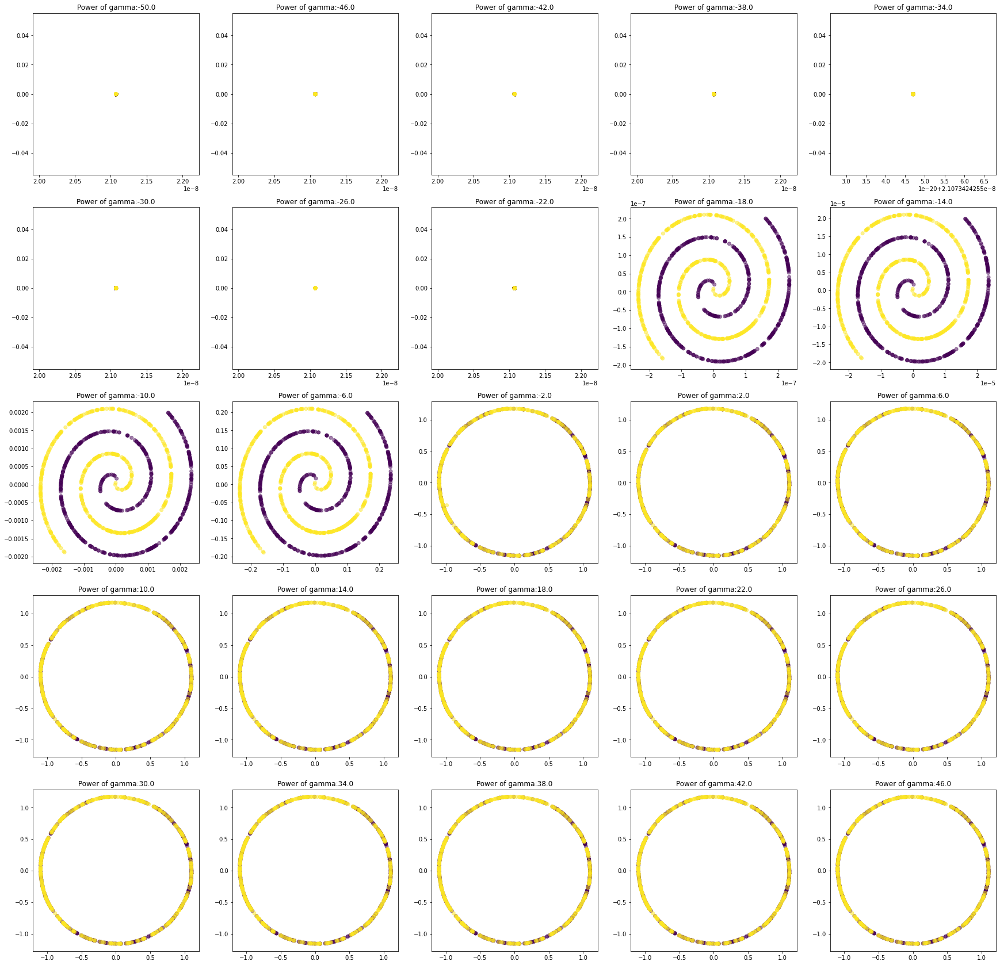

In [46]:
## (문제)  데이터 X_4 (Spiral)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 sigmoid 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma 값에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.


g_start=-50
g_end=50
g_power=np.arange(g_start,g_end,(g_end-g_start)/25)

fig,axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n , ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_4)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_4,alpha=0.5)
  ax.set_title("Power of gamma:" + str(g_power[n]))

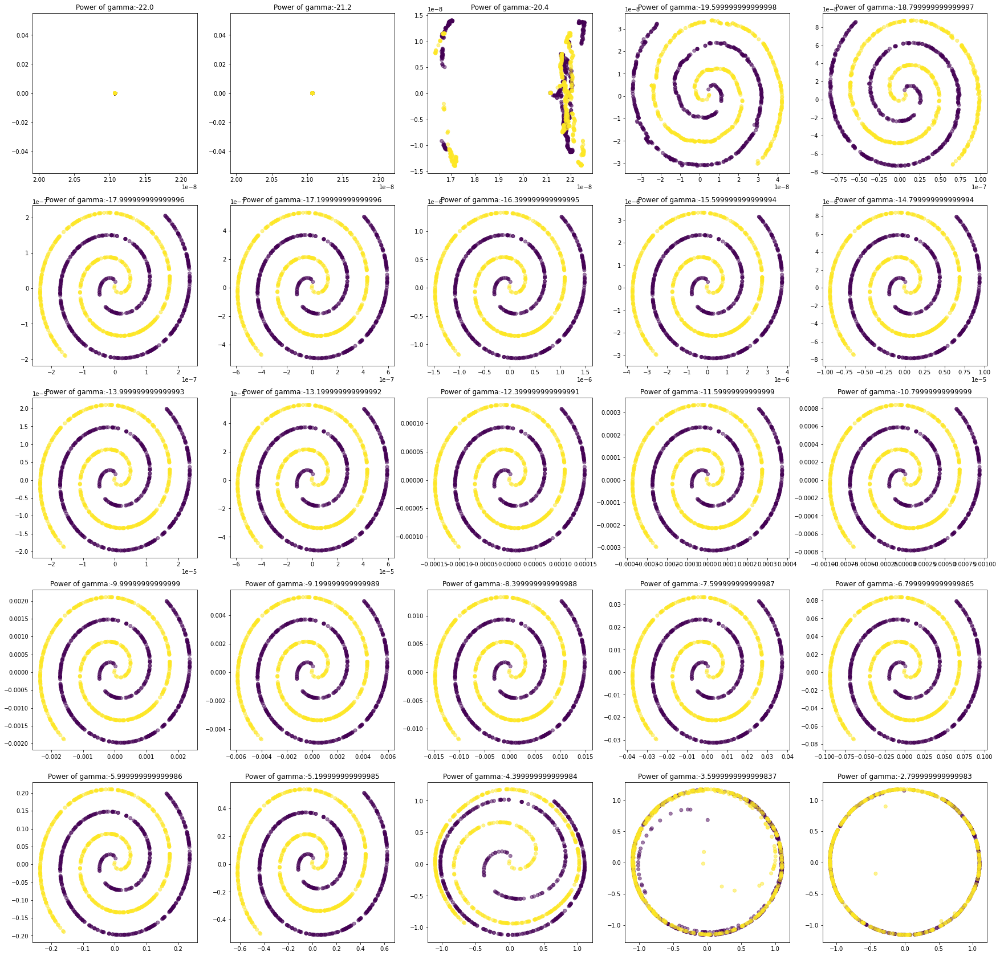

In [47]:


g_start=-22
g_end=-2
g_power=np.arange(g_start,g_end,(g_end-g_start)/25)

fig,axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n , ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_4)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_4,alpha=0.5)
  ax.set_title("Power of gamma:" + str(g_power[n]))

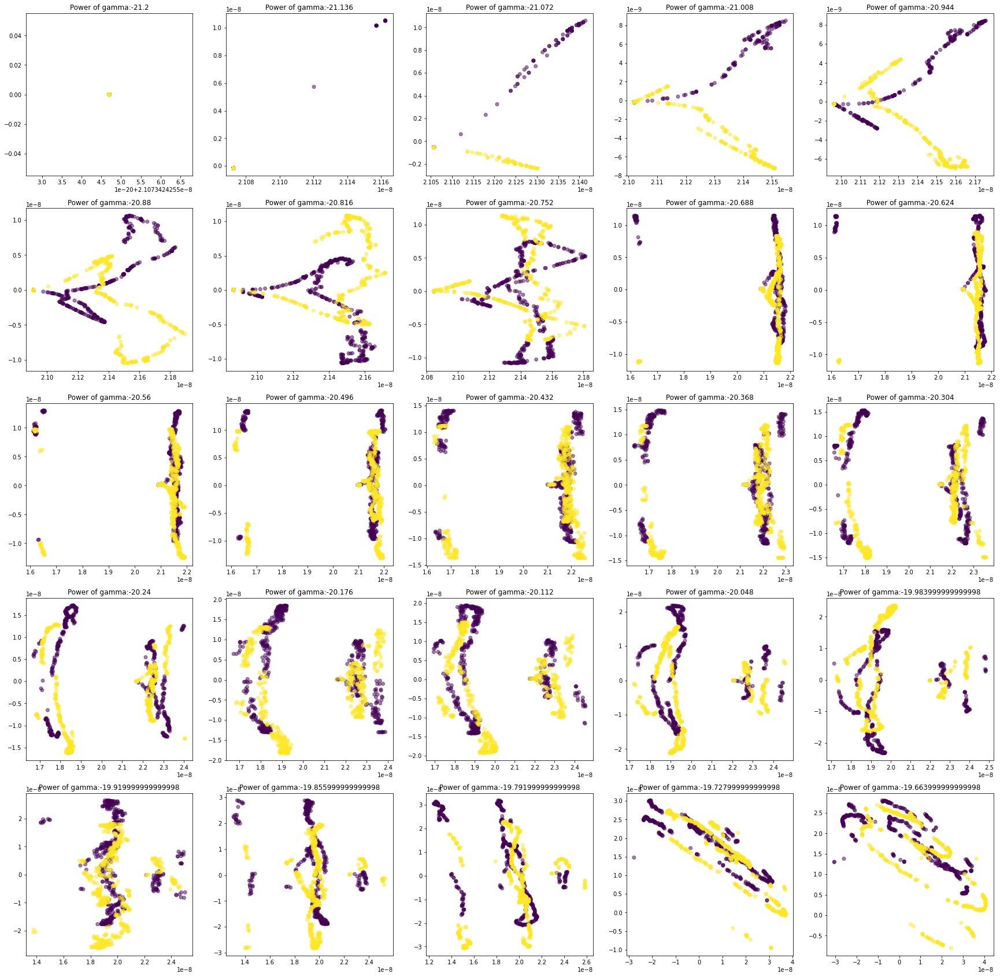

In [48]:


g_start=-21.2
g_end=-19.6
g_power=np.arange(g_start,g_end,(g_end-g_start)/25)

fig,axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)

for n , ax in enumerate(axs.flatten()):
  g_value=10**g_power[n]
  scikit_kpca=KernelPCA(n_components=2,kernel='sigmoid',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_4)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_4,alpha=0.5)
  ax.set_title("Power of gamma:" + str(g_power[n]))

##Step 6. PCA, Kernel PCA의 탐색적 데이터 분석에의 적용

- 아래와 같이 Steel Plate 예제를 준비합니다.

In [49]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [50]:
# 마운트가 제대로 진행되었는지 확인합니다. 
import os
os.chdir('/content/')
path = "./drive/MyDrive/data"
file_list = os.listdir(path)

print ("file_list: {}".format(file_list))

file_list: ['Faults.NNA', 'Faults27x7_var']


In [51]:
# 데이터를 읽어옵니다.
df = pd.read_csv("/content/drive/MyDrive/data/Faults.NNA",  delimiter='\t', header=None)
df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33
0,42,50,270900,270944,267,17,44,24220,76,108,1687,1,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,1.0,2.4265,0.9031,1.6435,0.8182,-0.2913,0.5822,1,0,0,0,0,0,0
1,645,651,2538079,2538108,108,10,30,11397,84,123,1687,1,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,1.0,2.0334,0.7782,1.4624,0.7931,-0.1756,0.2984,1,0,0,0,0,0,0
2,829,835,1553913,1553931,71,8,19,7972,99,125,1623,1,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.0,1.8513,0.7782,1.2553,0.6667,-0.1228,0.2150,1,0,0,0,0,0,0
3,853,860,369370,369415,176,13,45,18996,99,126,1353,0,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,1.0,2.2455,0.8451,1.6532,0.8444,-0.1568,0.5212,1,0,0,0,0,0,0
4,1289,1306,498078,498335,2409,60,260,246930,37,126,1353,0,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,1.0,3.3818,1.2305,2.4099,0.9338,-0.1992,1.0000,1,0,0,0,0,0,0


In [52]:
# 칼럼 레이블을 읽어와서 데이터 프레임의 칼럼명으로 지정합니다.
attributes_name=pd.read_csv("/content/drive/MyDrive/data/Faults27x7_var",  delimiter=' ', header=None)
df.columns=attributes_name[0]

In [53]:
df.head()

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,42,50,270900,270944,267,17,44,24220,76,108,1687,1,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,1.0,2.4265,0.9031,1.6435,0.8182,-0.2913,0.5822,1,0,0,0,0,0,0
1,645,651,2538079,2538108,108,10,30,11397,84,123,1687,1,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,1.0,2.0334,0.7782,1.4624,0.7931,-0.1756,0.2984,1,0,0,0,0,0,0
2,829,835,1553913,1553931,71,8,19,7972,99,125,1623,1,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.0,1.8513,0.7782,1.2553,0.6667,-0.1228,0.2150,1,0,0,0,0,0,0
3,853,860,369370,369415,176,13,45,18996,99,126,1353,0,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,1.0,2.2455,0.8451,1.6532,0.8444,-0.1568,0.5212,1,0,0,0,0,0,0
4,1289,1306,498078,498335,2409,60,260,246930,37,126,1353,0,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,1.0,3.3818,1.2305,2.4099,0.9338,-0.1992,1.0000,1,0,0,0,0,0,0


In [58]:
conditions_bf=[df['Pastry'],
               df['Z_Scratch'],
               df['K_Scatch'],
               df['Stains'],
               df['Dirtiness'],
               df['Bumps'],
               df['Other_Faults']
               ]
conditions=list(map(lambda i: i.astype(bool), conditions_bf))

In [59]:
# 범주화 진행합니다.

choices = ['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']
df['class']=np.select(conditions,choices)

In [60]:
df.head()

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults,class
0,42,50,270900,270944,267,17,44,24220,76,108,1687,1,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,1.0,2.4265,0.9031,1.6435,0.8182,-0.2913,0.5822,1,0,0,0,0,0,0,Pastry
1,645,651,2538079,2538108,108,10,30,11397,84,123,1687,1,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,1.0,2.0334,0.7782,1.4624,0.7931,-0.1756,0.2984,1,0,0,0,0,0,0,Pastry
2,829,835,1553913,1553931,71,8,19,7972,99,125,1623,1,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.0,1.8513,0.7782,1.2553,0.6667,-0.1228,0.2150,1,0,0,0,0,0,0,Pastry
3,853,860,369370,369415,176,13,45,18996,99,126,1353,0,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,1.0,2.2455,0.8451,1.6532,0.8444,-0.1568,0.5212,1,0,0,0,0,0,0,Pastry
4,1289,1306,498078,498335,2409,60,260,246930,37,126,1353,0,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,1.0,3.3818,1.2305,2.4099,0.9338,-0.1992,1.0000,1,0,0,0,0,0,0,Pastry


In [61]:
color_code = {'Pastry':'Red', 'Z_Scratch':'Blue', 'K_Scatch':'Green', 'Stains':'Black', 'Dirtiness':'Pink', 'Bumps':'Brown', 'Other_Faults':'Gold'}
color_list = [color_code.get(i) for i in df.loc[:,'class']]
df_corTarget = df[['K_Scatch','X_Minimum', 'X_Maximum', 'Y_Minimum', 'Y_Maximum', 'Pixels_Areas',
       'X_Perimeter', 'Y_Perimeter', 'Sum_of_Luminosity',
       'Minimum_of_Luminosity', 'Maximum_of_Luminosity', 'Length_of_Conveyer',
       'TypeOfSteel_A300', 'TypeOfSteel_A400', 'Steel_Plate_Thickness',
       'Edges_Index', 'Empty_Index', 'Square_Index', 'Outside_X_Index',
       'Edges_X_Index', 'Edges_Y_Index', 'Outside_Global_Index', 'LogOfAreas',
       'Log_X_Index', 'Log_Y_Index', 'Orientation_Index', 'Luminosity_Index',
       'SigmoidOfAreas']]
corr=df_corTarget.corr()

In [62]:
choices2 = ['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps']
X_5_bf3 = df[['X_Minimum', 'X_Maximum', 'Y_Minimum', 'Y_Maximum', 'Pixels_Areas',
       'X_Perimeter', 'Y_Perimeter', 'Sum_of_Luminosity',
       'Minimum_of_Luminosity', 'Maximum_of_Luminosity', 'Length_of_Conveyer',
       'TypeOfSteel_A300',  'Steel_Plate_Thickness',
       'Edges_Index', 'Empty_Index', 'Square_Index', 'Outside_X_Index',
       'Edges_X_Index', 'Edges_Y_Index', 'Outside_Global_Index', 'LogOfAreas',
       'Log_X_Index', 'Log_Y_Index', 'Orientation_Index', 'Luminosity_Index',
       'SigmoidOfAreas']]

import random
random.seed(2000)
y_5_bf=df['class']
X_5_bf2 = X_5_bf3
X_5_bf=X_5_bf2.loc[y_5_bf.isin(choices2),:]
ind_row=[]
for i in range(0,len(choices2)):  
   ind_row.extend(random.sample(np.where(df['class']==choices2[i])[0].tolist(),55))

X_5=X_5_bf.iloc[ind_row,:]

In [63]:
mapping_dic = {1:0, 3:1, 5:2}
y_5=y_5_bf[np.where(y_5_bf.isin(choices2))[0]][ind_row]
color_code = {'Pastry':'Red', 'Z_Scratch':'Blue', 'K_Scatch':'Green', 'Stains':'Black', 'Dirtiness':'Pink', 'Bumps':'Brown', 'Other_Faults':'Gold'}
y_color=[color_code.get(i) for i in y_5]

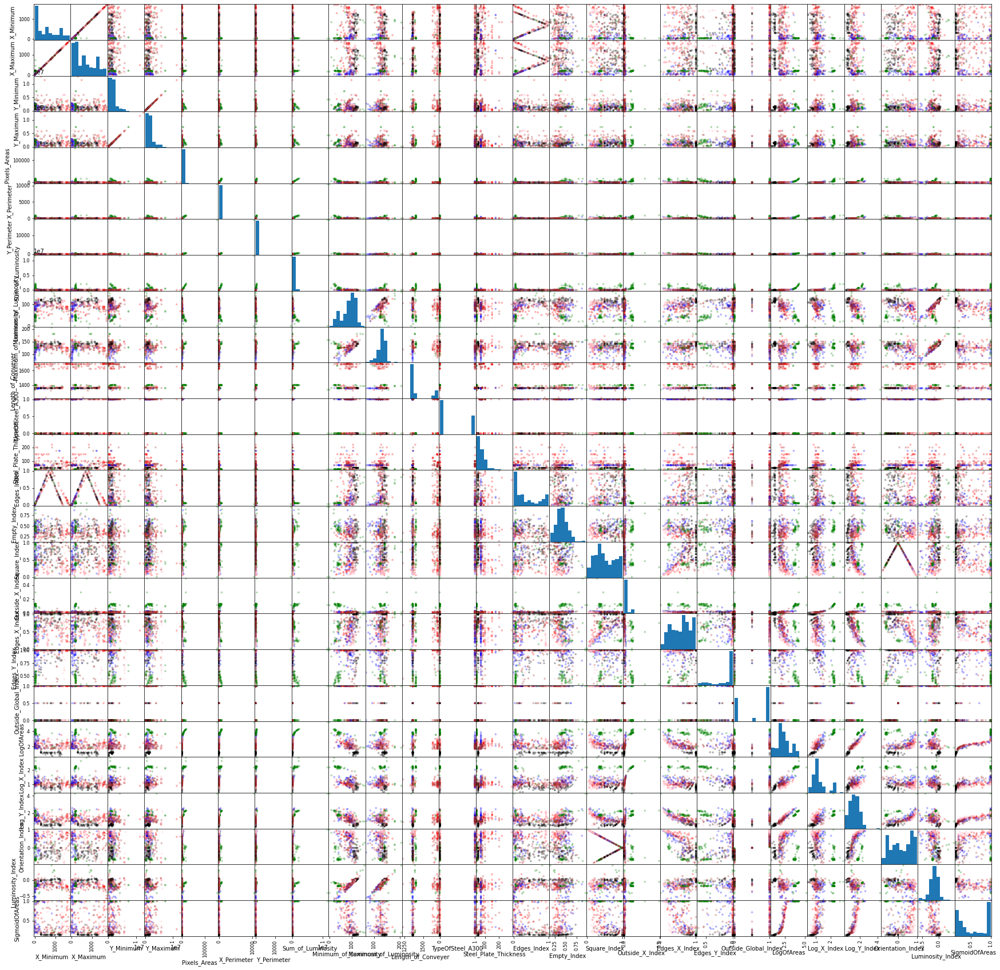

In [64]:
# scatter plot을 그리고 대각원소에는 히스토그램을 출력해봅니다.
pd.plotting.scatter_matrix(X_5,
                                       c=y_color,
                                       figsize= [30,30],
                                       diagonal='hist',
                                       alpha=0.3,
                                       s = 50)
plt.show()

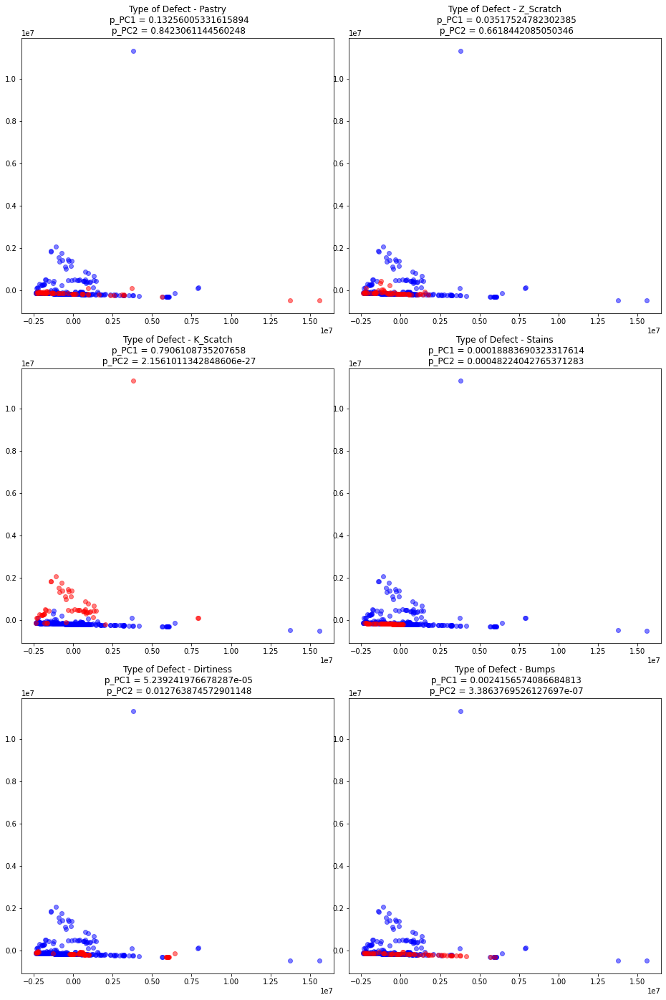

In [65]:
# 우선 PCA를 진행하여 데이터가 전반적으로 어느 Defect와 선형관계에 있는지를 살펴봅니다.
from sklearn.decomposition import PCA
from scipy import stats
scikit_pca = PCA(n_components=2)
X_spca = scikit_pca.fit_transform(X_5)

fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,24), sharex=False, sharey=False)

for n, ax in enumerate(axs.flatten()):  
    t, p = stats.ranksums(X_spca[y_5!=choices2[n], 0],X_spca[y_5==choices2[n], 0])
    t2, p2 = stats.ranksums(X_spca[y_5!=choices2[n], 1],X_spca[y_5==choices2[n], 1])  
    ax.scatter(X_spca[y_5!=choices2[n], 0], X_spca[y_5!=choices2[n], 1], color='blue', alpha=0.5)
    ax.scatter(X_spca[y_5==choices2[n], 0], X_spca[y_5==choices2[n], 1], color='red', alpha=0.5)
    ax.set_title('Type of Defect - ' + choices2[n]+"\n p_PC1 = " + str(p)+"\n p_PC2 = " + str(p2), size = 12)

plt.suptitle('', y = 0.95)
plt.subplots_adjust(wspace=0.05)
plt.show()

# 이번에는 차원의 개수가 너무 많아서, 저번처럼 단순한 패턴 분석의 차원, 주성분 뽑으면 좋지의 개념 이상
# 절실하게, 차원이 너무 많아서 볼래야 볼 수가 없어서, 진행이 안되서 선형으로 2차원으로 투영시킨 것이고,
# 차원이 너무 많으니까, 비선형 Kernel PCA를 써서 최대한 압축 및 요약을 하려고 PCA를 도입한 것이다.
# 결국, 이 여러 선택지 중 가장 관련성이 큰 변수는 무엇인가?를 파악하기 위해서, 시도했다.

### 문제 15. 탐색적 데이터 분석을 위한 Kernel PCA

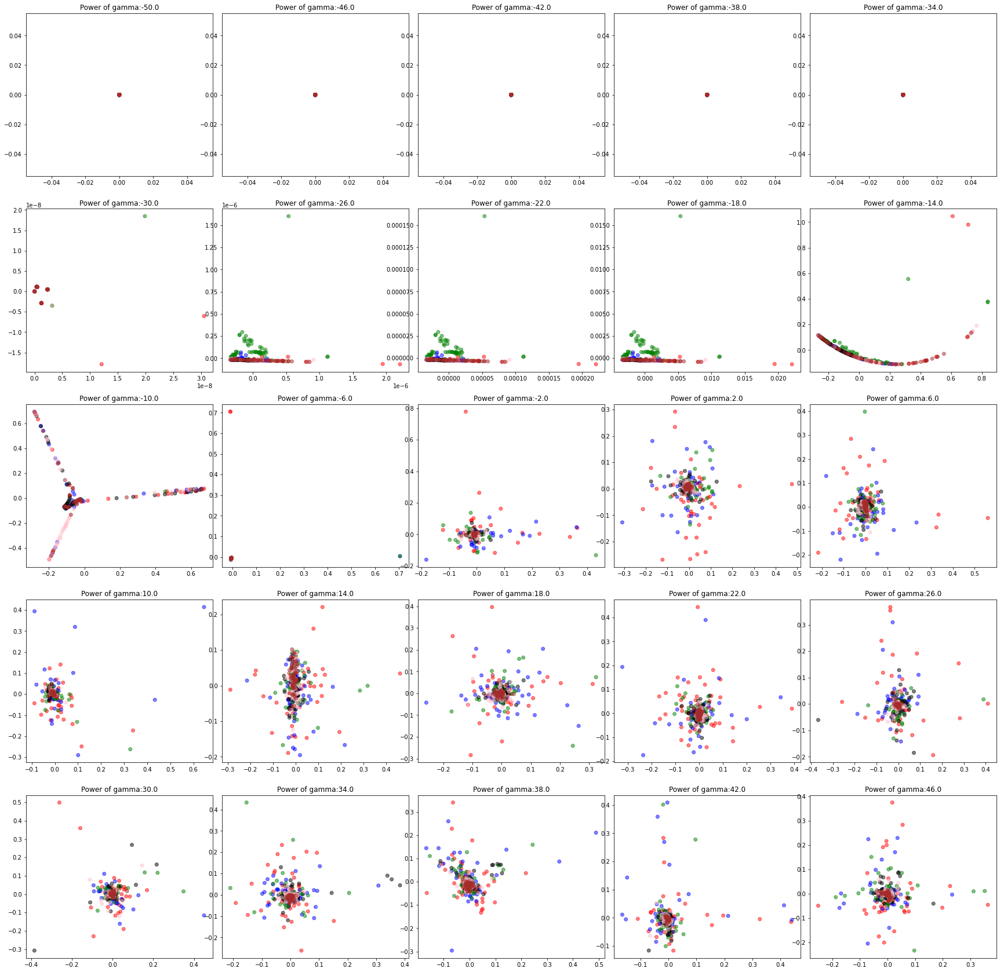

In [66]:
## (문제) PCA결과 Pastry가 데이터와 선형 관계가 없는 Defect인 것으로 관측됩니다. Pastry와 데이터 간의 비선형적 상관관계가 있는지를 알아보고 싶습니다.
# 데이터 X_5 (Steel Plate Faults 데이터)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 rbf로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.
from sklearn.decomposition import KernelPCA
color_code2 = {'Pastry':'Red', 'Z_Scratch':'Blue', 'K_Scatch':'Green', 'Stains':'Black', 'Dirtiness':'Pink', 'Bumps':'Brown', 'Other_Faults':'Gold'}

g_start=-50
g_end=50
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)
fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)
y_color2=[color_code2.get(i)for i in y_5]

for n , ax in enumerate(axs.flatten()):
  g_value=10**(g_power[n])
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_5)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_color2,alpha=0.5)
  ax.set_title('Power of gamma:' +str(g_power[n]))

plt.suptitle('', y = 0.95)
plt.subplots_adjust(wspace=0.05)
plt.show()


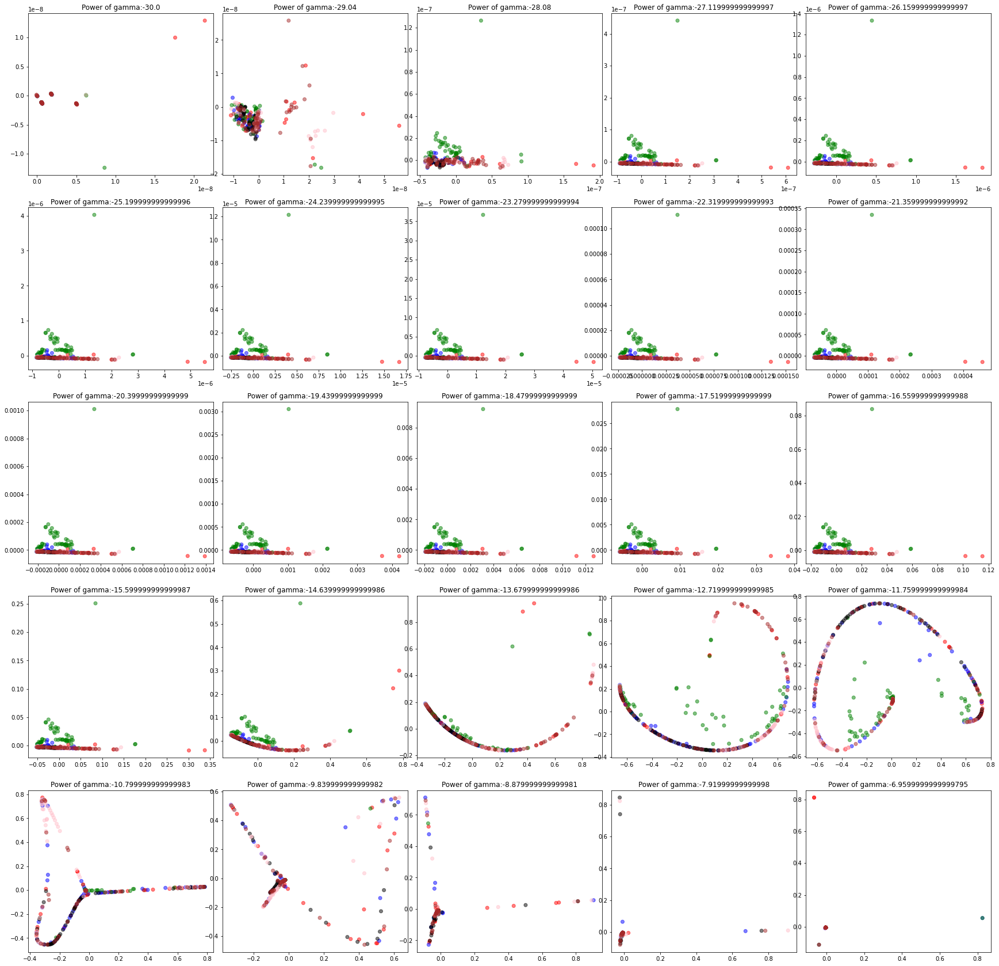

In [ ]:
## (문제) PCA결과 Pastry가 데이터와 선형 관계가 없는 Defect인 것으로 관측됩니다. Pastry와 데이터 간의 비선형적 상관관계가 있는지를 알아보고 싶습니다.
# 데이터 X_5 (Steel Plate Faults 데이터)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 rbf로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.
from sklearn.decomposition import KernelPCA
color_code2 = {'Pastry':'Red', 'Z_Scratch':'Blue', 'K_Scatch':'Green', 'Stains':'Black', 'Dirtiness':'Pink', 'Bumps':'Brown', 'Other_Faults':'Gold'}

g_start=-30
g_end=-6
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)
fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)
y_color2=[color_code2.get(i)for i in y_5]

for n , ax in enumerate(axs.flatten()):
  g_value=10**(g_power[n])
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_5)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_color2,alpha=0.5)
  ax.set_title('Power of gamma:' +str(g_power[n]))

plt.suptitle('', y = 0.95)
plt.subplots_adjust(wspace=0.05)
plt.show()


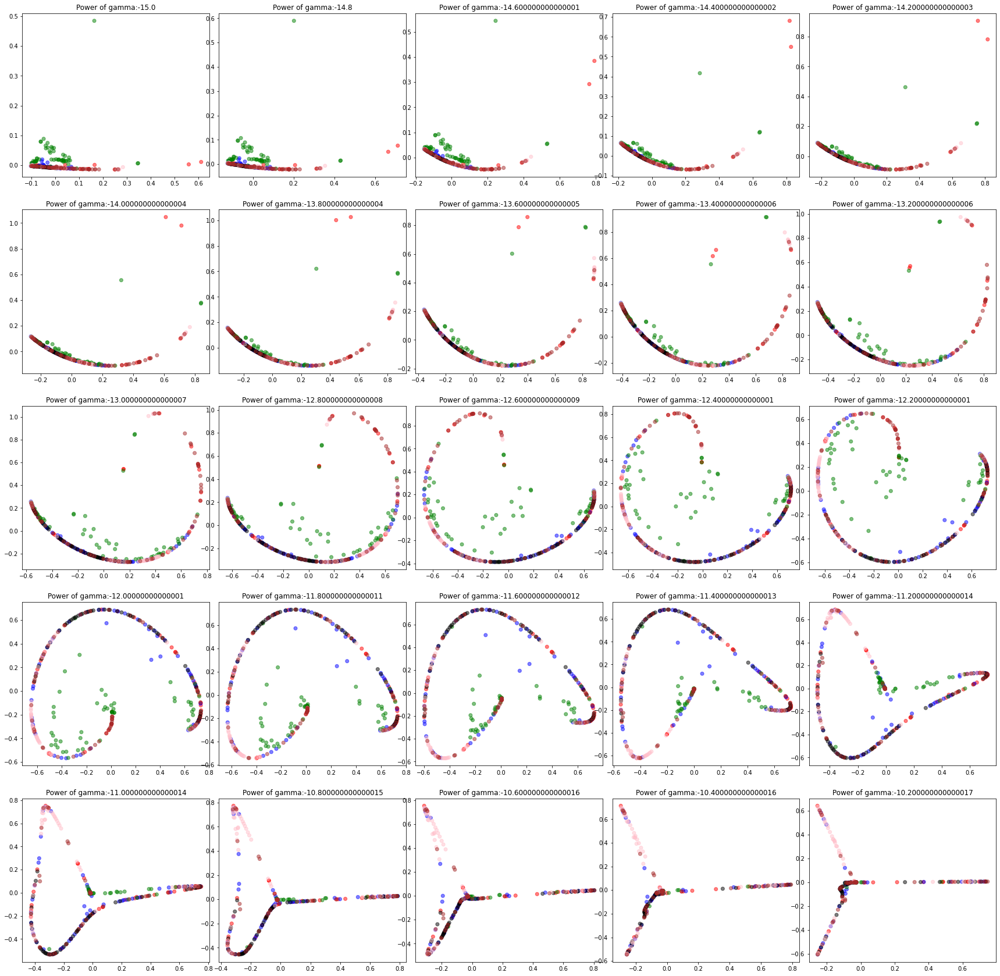

In [ ]:
## (문제) PCA결과 Pastry가 데이터와 선형 관계가 없는 Defect인 것으로 관측됩니다. Pastry와 데이터 간의 비선형적 상관관계가 있는지를 알아보고 싶습니다.
# 데이터 X_5 (Steel Plate Faults 데이터)를 이용하고 sklearn.decomposition.KernelPCA를 활용하여 KernelPCA를 진행하고 플랏을 그립니다.
# 커널은 rbf로 진행합니다.
# 비선형 관계 데이터를 선형으로 바꿔주는 적정한 gamma 값을 찾아야 합니다.
# 이를 결정하기 위하여 grid를 25개로 주고, 25개의 다양한 gamma값에 대하여 KenrnelPCA를 진행하고 플랏을 그린 후 적정 gamma에 대하여 고민해봅니다.
# 본 과정은 gamma의 범위를 좁혀가며 여러번 진행될 수 있습니다.
from sklearn.decomposition import KernelPCA
color_code2 = {'Pastry':'Red', 'Z_Scratch':'Blue', 'K_Scatch':'Green', 'Stains':'Black', 'Dirtiness':'Pink', 'Bumps':'Brown', 'Other_Faults':'Gold'}

g_start=-15
g_end=-10
g_power = np.arange(g_start,g_end,(g_end-g_start)/25)
fig, axs = plt.subplots(nrows=5,ncols=5,figsize=(30,30),sharex=False,sharey=False)
y_color2=[color_code2.get(i)for i in y_5]

for n , ax in enumerate(axs.flatten()):
  g_value=10**(g_power[n])
  scikit_kpca=KernelPCA(n_components=2,kernel='rbf',gamma=g_value)
  X_skernpca=scikit_kpca.fit_transform(X_5)
  ax.scatter(X_skernpca[:,0],X_skernpca[:,1],c=y_color2,alpha=0.5)
  ax.set_title('Power of gamma:' +str(g_power[n]))

plt.suptitle('', y = 0.95)
plt.subplots_adjust(wspace=0.05)
plt.show()


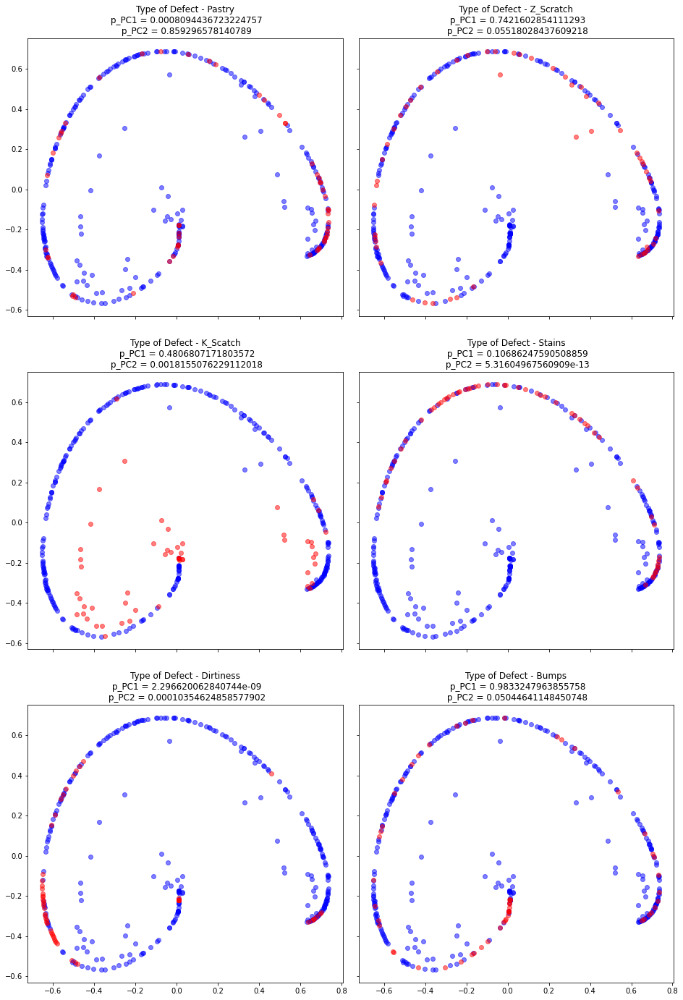

In [ ]:
# power of gamma는 -12로 지정하고 KernelPCA를 실시합ㄴ다.
g_power_val=-12
g_value=10**(g_power_val)
scikit_kpca = KernelPCA(n_components=2, kernel='rbf', gamma=g_value)
X_skernpca = scikit_kpca.fit_transform(X_5)

fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,24), sharex=True, sharey=True)

for n, ax in enumerate(axs.flatten()):
    t, p = stats.ranksums(X_skernpca[y_5!=choices2[n], 0],X_skernpca[y_5==choices2[n], 0])
    t2, p2 = stats.ranksums(X_skernpca[y_5!=choices2[n], 1],X_skernpca[y_5==choices2[n], 1]) #윌콕슨 순위 검정
    ax.scatter(X_skernpca[y_5!=choices2[n], 0], X_skernpca[y_5!=choices2[n], 1], color='blue', alpha=0.5)
    ax.scatter(X_skernpca[y_5==choices2[n], 0], X_skernpca[y_5==choices2[n], 1], color='red', alpha=0.5)
    ax.set_title('Type of Defect - ' + choices2[n]+"\n p_PC1 = " + str(p)+"\n p_PC2 = " + str(p2), size = 12)


plt.suptitle('', y = 0.95)
plt.subplots_adjust(wspace=0.05)
plt.show()

#비모수 검정 - 정규분포가 아닌 분포에 대해 윌콕슨 부호 및 순위 검정으로 통계량 (like p-value)

In [ ]:
# Box plot을 통하여 PC1, PC2와 Pastry의 상관관계를 통계적으로 검정함.
Target_defect="Pastry"
arry_tmp=np.array([X_skernpca[:,0],X_skernpca[:,1],np.select([y_5==Target_defect,y_5!=Target_defect],[Target_defect,"Others"])])
tips=pd.DataFrame(arry_tmp.transpose(),columns=["PC1","PC2","x_val"])
tips['PC1'] = pd.to_numeric(tips['PC1'])
tips['PC2'] = pd.to_numeric(tips['PC2'])
tips.head()

from scipy import stats
t, p = stats.ttest_ind(tips['PC1'][tips['x_val']==Target_defect], tips['PC1'][tips['x_val']!=Target_defect])
t2, p2 = stats.ttest_ind(tips['PC2'][tips['x_val']==Target_defect], tips['PC2'][tips['x_val']!=Target_defect])
print("t_PC1 = " + str(round(t,5)),"/ p_PC1 = " + str(p))
print("t_PC2 = " + str(round(t2,5)),"/ p_PC2 = " + str(p2))

# ttest로 t 통계량과 p-value를 뽑아보니, 유의하다고 나오네!

t_PC1 = 3.21067 / p_PC1 = 0.0014553380692986825
t_PC2 = -0.46121 / p_PC2 = 0.6449512926846837


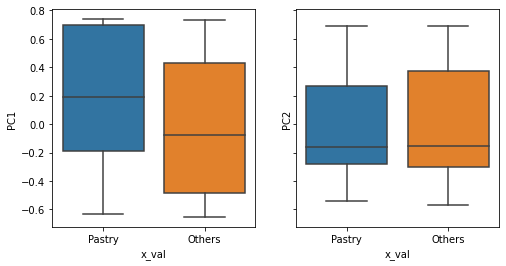

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(8,4), sharex=True, sharey=True)
for n, ax in enumerate(axs.flatten()):
    sns.boxplot(x="x_val", y="PC"+str(n+1),  data=tips, ax=axs[n])

plt.show()

#실제로 분포를 보니, 'Pastry'의 변수에 대해서 PC1으로 다른 변수들과 충분히 구분할 수 있다고 나왔고, 그림도 어느정도 차이가 보이네! 

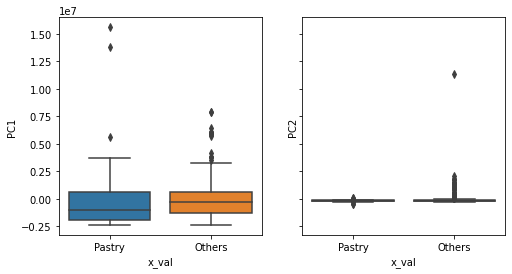

In [ ]:
arry_tmp2=np.array([X_spca[:,0],X_spca[:,1],np.select([y_5==Target_defect,y_5!=Target_defect],[Target_defect,"Others"])])
tips2=pd.DataFrame(arry_tmp2.transpose(),columns=["PC1","PC2","x_val"])
tips2['PC1'] = pd.to_numeric(tips2['PC1'])
tips2['PC2'] = pd.to_numeric(tips2['PC2'])
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(8,4), sharex=True, sharey=True)
for n, ax in enumerate(axs.flatten()):
    sns.boxplot(x="x_val", y="PC"+str(n+1),  data=tips2, ax=axs[n])

plt.show()

#그러나, 선형 PCA는 유의미한 주성분을 잡아내지 못했네

## Chapter 2. 요약 및 마무리
- 학습한 것:
 - 기초 학습 내용은 비지도학습의 개념과 Clustering과 PCA의 이해 및 활용, 선형 패턴 데이터와 비선형 패턴 데이터를 구분하고 각 데이터에 맞는 분석 방법을 아는 것입니다.
 - 심화 학습 내용은 비선형 패턴 데이터를  Kernel PCA와 그 파라미터들을 조절하여 선형 패턴 데이터로 변화시키는 것과 그 과정을 이해하는 것입니다.

- 본 강의의 활용:
 - Clustering과 PCA, Kernel PCA를 통하여 데이터의 패턴과 특성을 파악하고 이러한 패턴과 연관이 되어있는 변수를 찾아 연구의 방향성을 잡거나 변수가 많을 경우 차원을 축소하거나, 일련의 과정을 통하여 모형 성능의 향상에 기여할 수 있습니다.  